In [1]:
import os
n_jobs = 64
os.environ["OMP_NUM_THREADS"] = str(n_jobs)
import joblib
import click
import json
import time

import itertools
import collections.abc
import sys
from tqdm.notebook import tqdm
# !{sys.executable} -m pip install qcircuit

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pennylane as qml
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

# Qiskit
from qiskit import QuantumCircuit
from qiskit.quantum_info import Pauli, SparsePauliOp, Operator
from qiskit.primitives import StatevectorEstimator
from qiskit.circuit import Parameter, ParameterVector
from qiskit.transpiler.preset_passmanagers import generate_preset_pass_manager
from qiskit.quantum_info import SparsePauliOp
from qiskit_ibm_runtime import EstimatorV2 as Estimator
from qiskit_ibm_runtime import QiskitRuntimeService
from qiskit_aer import AerSimulator
from qiskit_aer.noise import NoiseModel
from qiskit_ibm_runtime.fake_provider import FakeQuebec
from qiskit_ibm_runtime import Batch
from qiskit_ibm_runtime import exceptions
# from qiskit_machine_learning.optimizers import SPSA, Minimizer


from joblib import dump, load
from QiskitRegressor import QiskitRegressor

In [2]:
from qiskit_aer.primitives import EstimatorV2

In [3]:
def mitarai(quantumcircuit,num_wires,paramname='x'):
    # encoding as proposed by Mitarai et al.
    num_features = num_wires
    features = ParameterVector(paramname,num_features*2)
    for i in range(num_wires):
        feature_idx = i % num_features  # Calculate the feature index using modulo
        quantumcircuit.ry(np.arcsin(features[feature_idx * 2]), i)
        quantumcircuit.rz(np.arccos(features[feature_idx * 2 + 1] ** 2), i)


def double_angle(quantumcircuit, num_wires,paramname='x'):
    #  creates a circuit that encodes features into wires via angle encoding with an RY then RZ gate
    #  the features are encoded 1-1 onto the qubits
    #  if more wires are passed then features the remaining wires will be filled from the beginning of the feature list
    num_features = num_wires
    features = ParameterVector(paramname,num_features*2)
    for i in range(num_wires):
        feature_index = i % num_features
        quantumcircuit.ry(features[feature_index], i)
        quantumcircuit.rz(features[feature_index], i)

def entangle_cnot(quantumcircuit,num_wires):
    #  entangles all of the wires in a circular fashion using cnot gates
    for i in range(num_wires):
        
        if i == num_wires - 1:
            quantumcircuit.cx(i, 0)
        else:
            quantumcircuit.cx(i, i+1)


def entangle_cz(quantumcircuit,num_wires):
    #  entangles all of the wires in a circular fashion using cz gates
    for i in range(num_wires):
        
        if i == num_wires - 1:
            quantumcircuit.cz(i, 0)
        else:
            quantumcircuit.cz(i, i+1)


def HardwareEfficient(quantumcircuit,num_wires,paramname='theta'):
    parameters = ParameterVector(paramname,num_wires*3)
    for qubit in range(num_wires):
        quantumcircuit.rx(parameters[qubit * 3], qubit)  
        quantumcircuit.rz(parameters[qubit * 3 + 1], qubit)  
        quantumcircuit.rx(parameters[qubit * 3 + 2], qubit)  
    entangle_cnot(quantumcircuit,num_wires)



In [4]:
# def circuit(nqubits):
#     qc = QuantumCircuit(nqubits)
#     mitarai(qc,nqubits)
#     entangle_cz(qc,nqubits)
#     qc.barrier()
#     mitarai(qc,nqubits,paramname='x1')
#     entangle_cz(qc,nqubits)
#     qc.barrier()
#     HardwareEfficient(qc,nqubits)
#     qc.barrier()
#     return qc


def circuit(nqubits,RUD=1,AL=1):
    qc = QuantumCircuit(nqubits)
    for i in range(RUD):
        double_angle(qc,nqubits,paramname=f'x{i}')
        qc.barrier()
        for j in range(AL):        
            HardwareEfficient(qc,nqubits,paramname=f'theta{i}_{j}')
            qc.barrier()
    return qc

In [5]:

top=os.getcwd()
with open(os.path.join(top,'0.1_5_DDCC_train.bin'),'rb') as f:
    ddcc_train = joblib.load(f)

with open(os.path.join(top,'0.1_5_DDCC_test.bin'),'rb') as f:
    ddcc_test = joblib.load(f)

with open(os.path.join(top,'0.1_5_DDCC_scaler.bin'),'rb') as f:
    ddcc_scaler = joblib.load(f)

X_ddcc_train, y_ddcc_train = ddcc_train['X'],ddcc_train['y']
X_ddcc_test, y_ddcc_test = ddcc_test['X'],ddcc_test['y']

X_ddcc_train = np.hstack([X_ddcc_train,X_ddcc_train]).reshape(-1,64,10)
X_ddcc_test = np.hstack([X_ddcc_test,X_ddcc_test]).reshape(-1,64,10)
y_ddcc_train = y_ddcc_train.reshape(-1,64)
y_ddcc_test = y_ddcc_test.reshape(-1,64)


# X_train, y_train = X_ddcc_train, y_ddcc_train
# X_test, y_test = X_ddcc_test, y_ddcc_test
X_train, y_train = X_ddcc_train, y_ddcc_train
X_test, y_test = X_ddcc_test, y_ddcc_test

# X_train = [X_train[i:i+4] for i in range(0,len(X_train),4)]
# X_test = [X_test[i:i+4] for i in range(0,len(X_test),4)]
scaler = ddcc_scaler

# print(len(X_train),X_train[0].shape,X_train[-1].shape)
print(X_ddcc_train.shape, X_ddcc_test.shape)

(19, 64, 10) (40, 64, 10)


/home/ubuntu/miniconda3/lib/python3.12/site-packages/sklearn/base.py:380: InconsistentVersionWarning: Trying to unpickle estimator MinMaxScaler from version 1.5.1 when using version 1.6.0. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [6]:
num_qubits = X_ddcc_train.shape[-1]
RUD = 1
AL = 5

In [7]:
optimization_level = None
shots = None
resilience_level = None

In [8]:
# 
qc = circuit(num_qubits,RUD,AL)

observables_labels = ''.join(['I']*(num_qubits-1))+"Z"

In [9]:
model = QiskitRegressor(qc,
                        num_qubits,
                        AL,
                        RUD,
                        'statevector', #'fake',
                        observables_labels,
                        channel='ibm_quantum',
                        instance='pinq-quebec-hub/univ-toronto/default',
                        parameterpath = None,
                        optimization_level = optimization_level,
                        resilience_level = resilience_level,
                        shots = shots,
                        iterations =1000,
                        verbose = True,
                        n_jobs = n_jobs)
model.fit(X_train,y_train)



None
Parameters from scratch
[-2.90318345  2.23743464 -2.12427964 -0.11653103  0.55388708 -2.77010897
  3.06858498  2.18960145  1.18551998 -1.06648308  0.6027151   1.14432445
  1.31029899 -1.8735468   0.7296508   2.88578419 -0.54534335 -0.47522485
 -2.0265424   0.7289737   1.60512664  2.83077107 -1.2645671  -0.25136105
 -2.39279218 -2.27309774  3.13337155  2.54856958 -0.67550787 -2.69002202
 -2.90318345  2.23743464 -2.12427964 -0.11653103  0.55388708 -2.77010897
  3.06858498  2.18960145  1.18551998 -1.06648308  0.6027151   1.14432445
  1.31029899 -1.8735468   0.7296508   2.88578419 -0.54534335 -0.47522485
 -2.0265424   0.7289737   1.60512664  2.83077107 -1.2645671  -0.25136105
 -2.39279218 -2.27309774  3.13337155  2.54856958 -0.67550787 -2.69002202
 -2.90318345  2.23743464 -2.12427964 -0.11653103  0.55388708 -2.77010897
  3.06858498  2.18960145  1.18551998 -1.06648308  0.6027151   1.14432445
  1.31029899 -1.8735468   0.7296508   2.88578419 -0.54534335 -0.47522485
 -2.0265424   0.728973

Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5500 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.5337 s
return (19, 64)
Iters. done: 1 Current cost: 0.12283164689459532 Accuracy: -0.2877579443717646 Time: 33.72608413361013


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3175 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.0557 s
return (19, 64)
Iters. done: 2 Current cost: 0.12028314346628421 Accuracy: -0.26103962202538633 Time: 36.07439140416682


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6628 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.3702 s
return (19, 64)
Iters. done: 3 Current cost: 0.11159544443068971 Accuracy: -0.16995842484011936 Time: 36.482736848294735


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4571 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.7542 s
return (19, 64)
Iters. done: 4 Current cost: 0.1232447771393969 Accuracy: -0.2920891714476339 Time: 34.54134967364371


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0788 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.3745 s
return (19, 64)
Iters. done: 5 Current cost: 0.1175024768127861 Accuracy: -0.2318873175157461 Time: 36.04199414886534


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0396 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.3942 s
return (19, 64)
Iters. done: 6 Current cost: 0.11005723277308353 Accuracy: -0.15383192704995774 Time: 33.80185662768781


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8370 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.2553 s
return (19, 64)
Iters. done: 7 Current cost: 0.11325673309691228 Accuracy: -0.18737525292888302 Time: 35.414972545579076


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7304 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.8557 s
return (19, 64)
Iters. done: 8 Current cost: 0.10963825394426312 Accuracy: -0.14943938384975075 Time: 36.89246606267989


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7651 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.4999 s
return (19, 64)
Iters. done: 9 Current cost: 0.11027049394010321 Accuracy: -0.15606774142677904 Time: 36.02695342153311


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2160 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.0234 s
return (19, 64)
Iters. done: 10 Current cost: 0.10441946575920007 Accuracy: -0.09472599267397741 Time: 37.57613620348275


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5814 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.5307 s
return (19, 64)
Iters. done: 11 Current cost: 0.10783502745296417 Accuracy: -0.13053449005096862 Time: 37.44806365482509


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1925 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.3077 s
return (19, 64)
Iters. done: 12 Current cost: 0.10479899120396267 Accuracy: -0.09870490949989685 Time: 36.82296814955771


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6050 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.7071 s
return (19, 64)
Iters. done: 13 Current cost: 0.10409304435676042 Accuracy: -0.09130381471876903 Time: 35.99700353294611


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4520 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8023 s
return (19, 64)
Iters. done: 14 Current cost: 0.11062706517588643 Accuracy: -0.159806008015424 Time: 34.57804115489125


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3476 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3645 s
return (19, 64)
Iters. done: 15 Current cost: 0.11382018906612983 Accuracy: -0.19328248383401148 Time: 34.061325984075665


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4103 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0349 s
return (19, 64)
Iters. done: 16 Current cost: 0.11233477627172074 Accuracy: -0.17770952543906948 Time: 35.175055880099535


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6542 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9810 s
return (19, 64)
Iters. done: 17 Current cost: 0.10825974795803255 Accuracy: -0.1349872285623126 Time: 36.41083788499236


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7378 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.5450 s
return (19, 64)
Iters. done: 18 Current cost: 0.10545458125331185 Accuracy: -0.10557806731911046 Time: 37.6431429553777


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6585 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.6592 s
return (19, 64)
Iters. done: 19 Current cost: 0.10829582696854356 Accuracy: -0.1353654782527245 Time: 36.63767744228244


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9854 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.4452 s
return (19, 64)
Iters. done: 20 Current cost: 0.09780031058824065 Accuracy: -0.025331257099464155 Time: 37.21290587075055


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1622 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8688 s
return (19, 64)
Iters. done: 21 Current cost: 0.09312772392857731 Accuracy: 0.023655797490062414 Time: 35.36898469552398


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5941 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.1969 s
return (19, 64)
Iters. done: 22 Current cost: 0.09587003605919409 Accuracy: -0.005094401024976936 Time: 36.12462591007352


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5169 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.4778 s
return (19, 64)
Iters. done: 23 Current cost: 0.10573561560427931 Accuracy: -0.10852441076763775 Time: 34.33086256682873


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1057 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.8494 s
return (19, 64)
Iters. done: 24 Current cost: 0.10023112693426023 Accuracy: -0.05081575673807648 Time: 36.74487862363458


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7998 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.4387 s
return (19, 64)
Iters. done: 25 Current cost: 0.09879716184486831 Accuracy: -0.03578217229545433 Time: 36.55776236206293


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4093 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.6827 s
return (19, 64)
Iters. done: 26 Current cost: 0.09937506580391532 Accuracy: -0.041840874862434596 Time: 33.42028386332095


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8596 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.3119 s
return (19, 64)
Iters. done: 27 Current cost: 0.10061707635179741 Accuracy: -0.05486202202169399 Time: 33.82369794137776


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4072 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9503 s
return (19, 64)
Iters. done: 28 Current cost: 0.10450315546980736 Accuracy: -0.09560338943956181 Time: 36.181915048509836


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7180 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.0567 s
return (19, 64)
Iters. done: 29 Current cost: 0.09337050246022352 Accuracy: 0.02111052523527779 Time: 33.0541343446821


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2981 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.1583 s
return (19, 64)
Iters. done: 30 Current cost: 0.09979773179134954 Accuracy: -0.04627207396213606 Time: 34.7841556891799


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6157 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.7005 s
return (19, 64)
Iters. done: 31 Current cost: 0.09362898681927793 Accuracy: 0.018400594242055757 Time: 35.933878909796476


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8031 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.1212 s
return (19, 64)
Iters. done: 32 Current cost: 0.10474323068613618 Accuracy: -0.09812032033555096 Time: 35.68641179613769


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3716 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.9895 s
return (19, 64)
Iters. done: 33 Current cost: 0.09351969481055376 Accuracy: 0.01954640361650528 Time: 32.70542515814304


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1314 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.2254 s
return (19, 64)
Iters. done: 34 Current cost: 0.09508996894553454 Accuracy: 0.003083765173676034 Time: 30.676933420822024


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1570 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.2904 s
return (19, 64)
Iters. done: 35 Current cost: 0.09807203369286899 Accuracy: -0.028179982126775416 Time: 34.06632383354008


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5744 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.4399 s
return (19, 64)
Iters. done: 36 Current cost: 0.09600999374095587 Accuracy: -0.006561707058243993 Time: 33.706316536292434


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0470 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.7250 s
return (19, 64)
Iters. done: 37 Current cost: 0.09319819789982955 Accuracy: 0.022916953563062226 Time: 37.093693133443594


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2130 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.4836 s
return (19, 64)
Iters. done: 38 Current cost: 0.10088318396367894 Accuracy: -0.05765187463640564 Time: 34.983527624979615


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6533 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.6074 s
return (19, 64)
Iters. done: 39 Current cost: 0.1019636703589813 Accuracy: -0.06897961446985601 Time: 34.10874633677304


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8376 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.6000 s
return (19, 64)
Iters. done: 40 Current cost: 0.10091471809583884 Accuracy: -0.0579824761567338 Time: 33.760353257879615


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9354 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.5514 s
return (19, 64)
Iters. done: 41 Current cost: 0.09650204049957778 Accuracy: -0.011720289055939359 Time: 33.80033332668245


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7352 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3843 s
return (19, 64)
Iters. done: 42 Current cost: 0.0995449941648407 Accuracy: -0.04362239128990297 Time: 34.44985621608794


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1790 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.5880 s
return (19, 64)
Iters. done: 43 Current cost: 0.09843955890037413 Accuracy: -0.03203308934862825 Time: 35.64459449239075


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2441 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.1667 s
return (19, 64)
Iters. done: 44 Current cost: 0.10404842041830267 Accuracy: -0.09083598063275833 Time: 35.71008329279721


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5863 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.9254 s
return (19, 64)
Iters. done: 45 Current cost: 0.1001345012767321 Accuracy: -0.049802740457192574 Time: 37.845790419727564


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7067 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3671 s
return (19, 64)
Iters. done: 46 Current cost: 0.0991403203194738 Accuracy: -0.03937982048322919 Time: 34.675620310008526


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1147 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9758 s
return (19, 64)
Iters. done: 47 Current cost: 0.10162997495886142 Accuracy: -0.0654811764584089 Time: 36.40060321241617


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6381 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.5827 s
return (19, 64)
Iters. done: 48 Current cost: 0.10152010849160986 Accuracy: -0.0643293445030444 Time: 35.57389657944441


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5202 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.7654 s
return (19, 64)
Iters. done: 49 Current cost: 0.10090413433967342 Accuracy: -0.05787151683616876 Time: 35.93126147426665


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5844 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.8202 s
return (19, 64)
Iters. done: 50 Current cost: 0.09162021927704105 Accuracy: 0.03946036528893826 Time: 34.267205495387316


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7237 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.6439 s
return (19, 64)
Iters. done: 51 Current cost: 0.09585930854365123 Accuracy: -0.0049819345416808325 Time: 35.7101735137403


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6846 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.3288 s
return (19, 64)
Iters. done: 52 Current cost: 0.10438427864354276 Accuracy: -0.09435709354355937 Time: 35.32553195208311


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0015 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.7615 s
return (19, 64)
Iters. done: 53 Current cost: 0.09666526651201708 Accuracy: -0.013431538555241707 Time: 34.61020280979574


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9645 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9488 s
return (19, 64)
Iters. done: 54 Current cost: 0.10089617902491947 Accuracy: -0.05778811390188121 Time: 36.25057504884899


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7449 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.6213 s
return (19, 64)
Iters. done: 55 Current cost: 0.09871978181332249 Accuracy: -0.03497092574069338 Time: 34.64458061568439


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6242 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.9056 s
return (19, 64)
Iters. done: 56 Current cost: 0.09679814564884333 Accuracy: -0.014824633644458407 Time: 34.80550646968186


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3670 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.7250 s
return (19, 64)
Iters. done: 57 Current cost: 0.09135441063833186 Accuracy: 0.04224708349091866 Time: 35.01467854343355


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8275 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.0625 s
return (19, 64)
Iters. done: 58 Current cost: 0.09906569695928351 Accuracy: -0.0385974746680402 Time: 37.222979091107845


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4632 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.9398 s
return (19, 64)
Iters. done: 59 Current cost: 0.09789008963530335 Accuracy: -0.02627249402020926 Time: 36.732895504683256


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2053 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.0021 s
return (19, 64)
Iters. done: 60 Current cost: 0.08990947485956899 Accuracy: 0.05739568383335014 Time: 34.06348502077162


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7126 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 36.4074 s
return (19, 64)
Iters. done: 61 Current cost: 0.09955444214955567 Accuracy: -0.0437214432661861 Time: 38.44185522571206


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7770 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.2617 s
return (19, 64)
Iters. done: 62 Current cost: 0.09386602804900222 Accuracy: 0.01591547143829608 Time: 37.30203637480736


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5419 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0362 s
return (19, 64)
Iters. done: 63 Current cost: 0.10262745950594318 Accuracy: -0.07593873102490356 Time: 34.204522516578436


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5302 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.1963 s
return (19, 64)
Iters. done: 64 Current cost: 0.1015631577555557 Accuracy: -0.0647806698173845 Time: 33.38158259540796


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6564 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.7811 s
return (19, 64)
Iters. done: 65 Current cost: 0.1024273602924994 Accuracy: -0.0738409056005167 Time: 36.753336591646075


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1992 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.0078 s
return (19, 64)
Iters. done: 66 Current cost: 0.09688718447258206 Accuracy: -0.015758110118363033 Time: 36.48037649318576


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4625 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.4521 s
return (19, 64)
Iters. done: 67 Current cost: 0.10474064663968875 Accuracy: -0.09809322938280829 Time: 33.563115457072854


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0119 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.7070 s
return (19, 64)
Iters. done: 68 Current cost: 0.09259969355419231 Accuracy: 0.02919162906665418 Time: 37.03078339993954


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5060 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.2460 s
return (19, 64)
Iters. done: 69 Current cost: 0.0996502567156121 Accuracy: -0.04472595612378538 Time: 35.09350992552936


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8579 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.3220 s
return (19, 64)
Iters. done: 70 Current cost: 0.10086150673315038 Accuracy: -0.05742461214721106 Time: 35.51817370019853


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9380 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.1272 s
return (19, 64)
Iters. done: 71 Current cost: 0.09784844754613846 Accuracy: -0.0258359214226902 Time: 35.746834395453334


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5827 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.2841 s
return (19, 64)
Iters. done: 72 Current cost: 0.09844866741297818 Accuracy: -0.032128582324288946 Time: 35.19757321290672


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0224 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.1958 s
return (19, 64)
Iters. done: 73 Current cost: 0.09448170458337103 Accuracy: 0.009460763972091946 Time: 34.5052808765322


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7456 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.2073 s
return (19, 64)
Iters. done: 74 Current cost: 0.09517697597478376 Accuracy: 0.002171589883638414 Time: 36.74054921232164


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6526 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.7987 s
return (19, 64)
Iters. done: 75 Current cost: 0.10339191724591232 Accuracy: -0.08395324969879625 Time: 34.79891812801361


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4105 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.5349 s
return (19, 64)
Iters. done: 76 Current cost: 0.10187776567934956 Accuracy: -0.06807899613206381 Time: 36.27887907996774


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8377 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.5677 s
return (19, 64)
Iters. done: 77 Current cost: 0.09943546880557325 Accuracy: -0.042474135485534914 Time: 31.679609110578895


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0165 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.4500 s
return (19, 64)
Iters. done: 78 Current cost: 0.0979629622821851 Accuracy: -0.027036485485941952 Time: 36.22039929404855


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7979 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.4141 s
return (19, 64)
Iters. done: 79 Current cost: 0.09924389316848072 Accuracy: -0.04046567060819184 Time: 36.53249993920326


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7123 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8980 s
return (19, 64)
Iters. done: 80 Current cost: 0.08677006631751893 Accuracy: 0.09030901189548035 Time: 34.888775983825326


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2909 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.2587 s
return (19, 64)
Iters. done: 81 Current cost: 0.09059346226708401 Accuracy: 0.05022481020146308 Time: 35.25787963159382


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5983 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0445 s
return (19, 64)
Iters. done: 82 Current cost: 0.10081189625843236 Accuracy: -0.05690449958210797 Time: 34.496005510911345


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9482 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.1527 s
return (19, 64)
Iters. done: 83 Current cost: 0.098776927634095 Accuracy: -0.03557003831915284 Time: 34.4235857501626


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1828 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3672 s
return (19, 64)
Iters. done: 84 Current cost: 0.08993221891840021 Accuracy: 0.057157236794760036 Time: 33.93074880167842


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6388 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.0989 s
return (19, 64)
Iters. done: 85 Current cost: 0.09580138526423267 Accuracy: -0.004374671144005138 Time: 33.500132424756885


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.3352 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.0157 s
return (19, 64)
Iters. done: 86 Current cost: 0.09487042438293898 Accuracy: 0.005385454207192497 Time: 33.647935243323445


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3472 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.9756 s
return (19, 64)
Iters. done: 87 Current cost: 0.09307892676738219 Accuracy: 0.02416738333605961 Time: 31.641471296548843


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7041 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.4918 s
return (19, 64)
Iters. done: 88 Current cost: 0.09466044261250964 Accuracy: 0.007586887631558015 Time: 34.07005951553583


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8142 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.4956 s
return (19, 64)
Iters. done: 89 Current cost: 0.09771581210253732 Accuracy: -0.024445381195307148 Time: 35.62870116531849


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8170 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.5153 s
return (19, 64)
Iters. done: 90 Current cost: 0.0915109462898678 Accuracy: 0.040605975242848036 Time: 31.607902443036437


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2513 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.2350 s
return (19, 64)
Iters. done: 91 Current cost: 0.09844783347389169 Accuracy: -0.03211983936829266 Time: 31.334409268572927


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6535 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.8518 s
return (19, 64)
Iters. done: 92 Current cost: 0.0980237779726228 Accuracy: -0.027674072707831288 Time: 32.86172468960285


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0504 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.7977 s
return (19, 64)
Iters. done: 93 Current cost: 0.0870923315364907 Accuracy: 0.08693040706181143 Time: 36.206229727715254


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6834 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0394 s
return (19, 64)
Iters. done: 94 Current cost: 0.09361551496666769 Accuracy: 0.018541832153154858 Time: 34.012595005333424


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3660 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.3597 s
return (19, 64)
Iters. done: 95 Current cost: 0.09860196018015499 Accuracy: -0.033735692411448026 Time: 35.406894735991955


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1293 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.3082 s
return (19, 64)
Iters. done: 96 Current cost: 0.09386337725267567 Accuracy: 0.015943262191857932 Time: 37.750687554478645


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0811 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.6957 s
return (19, 64)
Iters. done: 97 Current cost: 0.09818982294475345 Accuracy: -0.02941487597303305 Time: 35.10077914968133


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4747 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.3083 s
return (19, 64)
Iters. done: 98 Current cost: 0.10326863717652221 Accuracy: -0.08266079052598996 Time: 35.56393483094871


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2439 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.1056 s
return (19, 64)
Iters. done: 99 Current cost: 0.09702705750983424 Accuracy: -0.017224528744822276 Time: 33.667115895077586


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6639 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.3207 s
return (19, 64)
Iters. done: 100 Current cost: 0.09505561327688554 Accuracy: 0.003443947474861875 Time: 35.31648418493569


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7749 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0570 s
return (19, 64)
Iters. done: 101 Current cost: 0.09284644622454509 Accuracy: 0.02660469223420736 Time: 34.7176721226424


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6541 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.7314 s
return (19, 64)
Iters. done: 102 Current cost: 0.09089121637293245 Accuracy: 0.04710317807350939 Time: 35.71146614104509


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6726 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0827 s
return (19, 64)
Iters. done: 103 Current cost: 0.09581756787103375 Accuracy: -0.0045443284025015185 Time: 34.10289032757282


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5041 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.4491 s
return (19, 64)
Iters. done: 104 Current cost: 0.09637357172723392 Accuracy: -0.010373431903307972 Time: 36.755958408117294


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3401 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.8830 s
return (19, 64)
Iters. done: 105 Current cost: 0.09541844348269024 Accuracy: -0.0003599376947638344 Time: 35.90264729782939


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6530 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3833 s
return (19, 64)
Iters. done: 106 Current cost: 0.09196803962367657 Accuracy: 0.03581384237796237 Time: 34.368338415399194


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7863 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.4758 s
return (19, 64)
Iters. done: 107 Current cost: 0.09260911695170539 Accuracy: 0.029092834860786065 Time: 33.58077408187091


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6392 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.5008 s
return (19, 64)
Iters. done: 108 Current cost: 0.10697348541453977 Accuracy: -0.1215021467384727 Time: 36.95612834021449


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8942 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.4198 s
return (19, 64)
Iters. done: 109 Current cost: 0.09549189944705908 Accuracy: -0.0011300446180928514 Time: 36.67083887383342


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6855 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8405 s
return (19, 64)
Iters. done: 110 Current cost: 0.09186220568881179 Accuracy: 0.03692339756061991 Time: 34.85526118427515


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5503 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.3985 s
return (19, 64)
Iters. done: 111 Current cost: 0.08804708273387025 Accuracy: 0.07692086578798119 Time: 37.78874372690916


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9419 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.0297 s
return (19, 64)
Iters. done: 112 Current cost: 0.09412682734031791 Accuracy: 0.013181270865649797 Time: 36.30167226679623


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3432 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9074 s
return (19, 64)
Iters. done: 113 Current cost: 0.09898296394694615 Accuracy: -0.03773010785669495 Time: 35.586058877408504


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6344 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.8416 s
return (19, 64)
Iters. done: 114 Current cost: 0.09404813204366438 Accuracy: 0.014006306562983073 Time: 36.355439668521285


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5514 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0452 s
return (19, 64)
Iters. done: 115 Current cost: 0.10504601179365562 Accuracy: -0.10129465517898417 Time: 35.40243156068027


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8402 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9157 s
return (19, 64)
Iters. done: 116 Current cost: 0.09234700339041457 Accuracy: 0.03184081414310791 Time: 36.13279776275158


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1164 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0863 s
return (19, 64)
Iters. done: 117 Current cost: 0.09228841108134773 Accuracy: 0.03245509159836879 Time: 35.522886879742146


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3379 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.2283 s
return (19, 64)
Iters. done: 118 Current cost: 0.08589925441425655 Accuracy: 0.0994385397885803 Time: 33.42512251995504


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5681 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.0881 s
return (19, 64)
Iters. done: 119 Current cost: 0.09159798626689161 Accuracy: 0.03969345453076689 Time: 31.019115660339594


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4880 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8156 s
return (19, 64)
Iters. done: 120 Current cost: 0.09139331835060938 Accuracy: 0.0418391778994085 Time: 34.64912652783096


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1205 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.6779 s
return (19, 64)
Iters. done: 121 Current cost: 0.09385372795792113 Accuracy: 0.016044424687777337 Time: 31.571395000442863


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.3233 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.4463 s
return (19, 64)
Iters. done: 122 Current cost: 0.08589925441425655 Accuracy: 0.0994385397885803 Time: 34.09830741211772


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3366 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.4444 s
return (19, 64)
Iters. done: 123 Current cost: 0.08589925441425655 Accuracy: 0.0994385397885803 Time: 32.1151854544878


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6210 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.5844 s
return (19, 64)
Iters. done: 124 Current cost: 0.08589925441425655 Accuracy: 0.0994385397885803 Time: 35.09112763591111


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9960 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.9839 s
return (19, 64)
Iters. done: 125 Current cost: 0.09060835942900916 Accuracy: 0.05006862945242396 Time: 35.342149110510945


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5117 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0813 s
return (19, 64)
Iters. done: 126 Current cost: 0.0895277837596034 Accuracy: 0.06139730522900311 Time: 33.911025835201144


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3646 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.4021 s
return (19, 64)
Iters. done: 127 Current cost: 0.08871796583992464 Accuracy: 0.06988737668799627 Time: 34.634218603372574


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1396 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0726 s
return (19, 64)
Iters. done: 128 Current cost: 0.09543066831281045 Accuracy: -0.00048810191387094193 Time: 35.49401477724314


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7519 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.2523 s
return (19, 64)
Iters. done: 129 Current cost: 0.09377454121596569 Accuracy: 0.01687461266148027 Time: 35.37636403180659


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4817 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.9875 s
return (19, 64)
Iters. done: 130 Current cost: 0.10601770163063313 Accuracy: -0.1114817799035015 Time: 38.26375361159444


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.5472 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.8365 s
return (19, 64)
Iters. done: 131 Current cost: 0.09104270796979955 Accuracy: 0.04551495132329264 Time: 34.706923577934504


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7213 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.1054 s
return (19, 64)
Iters. done: 132 Current cost: 0.09575455363311422 Accuracy: -0.003883691770648401 Time: 36.161583648994565


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4280 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.1966 s
return (19, 64)
Iters. done: 133 Current cost: 0.0949006243267168 Accuracy: 0.005068840219652038 Time: 35.89521989226341


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5568 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.3822 s
return (19, 64)
Iters. done: 134 Current cost: 0.09214955834912229 Accuracy: 0.033910813422032504 Time: 35.782972449436784


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7908 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.9558 s
return (19, 64)
Iters. done: 135 Current cost: 0.0932086869696489 Accuracy: 0.022806986927179418 Time: 38.08260810934007


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8584 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9305 s
return (19, 64)
Iters. done: 136 Current cost: 0.08950265232059125 Accuracy: 0.061660781385674324 Time: 36.102329758927226


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7862 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.8065 s
return (19, 64)
Iters. done: 137 Current cost: 0.10097729729106651 Accuracy: -0.05863855183302902 Time: 33.4243669398129


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2098 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.1698 s
return (19, 64)
Iters. done: 138 Current cost: 0.0863425627631035 Accuracy: 0.09479092769131792 Time: 36.6990436129272


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9257 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.7867 s
return (19, 64)
Iters. done: 139 Current cost: 0.0987329603789177 Accuracy: -0.035109088852315784 Time: 34.98724894411862


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5304 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.3501 s
return (19, 64)
Iters. done: 140 Current cost: 0.09449605340485105 Accuracy: 0.009310331983916065 Time: 36.662286629900336


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3446 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.5340 s
return (19, 64)
Iters. done: 141 Current cost: 0.10475351774044095 Accuracy: -0.09822816905564902 Time: 36.23639069125056


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8083 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0014 s
return (19, 64)
Iters. done: 142 Current cost: 0.101546088569231 Accuracy: -0.0646017177244238 Time: 35.14164559729397


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3933 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.5107 s
return (19, 64)
Iters. done: 143 Current cost: 0.09992931658399773 Accuracy: -0.04765159924226703 Time: 36.70376287586987


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0403 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.1629 s
return (19, 64)
Iters. done: 144 Current cost: 0.08569461440526051 Accuracy: 0.1015839705792877 Time: 34.47795097902417


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6705 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8731 s
return (19, 64)
Iters. done: 145 Current cost: 0.0932969422074809 Accuracy: 0.021881725510241035 Time: 34.81763463653624


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7401 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.6081 s
return (19, 64)
Iters. done: 146 Current cost: 0.10101317162725684 Accuracy: -0.05901465573292897 Time: 36.22462427057326


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0394 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8787 s
return (19, 64)
Iters. done: 147 Current cost: 0.08573261600048694 Accuracy: 0.1011855646522416 Time: 35.26823763176799


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6195 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 36.1657 s
return (19, 64)
Iters. done: 148 Current cost: 0.097963305118652 Accuracy: -0.027040079758224866 Time: 38.11201513558626


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7257 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.6117 s
return (19, 64)
Iters. done: 149 Current cost: 0.10223364239370634 Accuracy: -0.07180998140919792 Time: 35.28044311143458


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7346 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.5982 s
return (19, 64)
Iters. done: 150 Current cost: 0.08825054331837784 Accuracy: 0.07478779999679297 Time: 33.61643479578197


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5994 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.6372 s
return (19, 64)
Iters. done: 151 Current cost: 0.10481478011391761 Accuracy: -0.09887043926963823 Time: 34.51332410611212


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5090 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.5199 s
return (19, 64)
Iters. done: 152 Current cost: 0.09904704325829607 Accuracy: -0.038401910639991765 Time: 32.310342187061906


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0246 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.2352 s
return (19, 64)
Iters. done: 153 Current cost: 0.08969228729333241 Accuracy: 0.05967266229053825 Time: 34.57259892858565


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5441 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8657 s
return (19, 64)
Iters. done: 154 Current cost: 0.09445796074982046 Accuracy: 0.00970969257524601 Time: 34.74783396534622


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5568 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.8515 s
return (19, 64)
Iters. done: 155 Current cost: 0.08833348930759698 Accuracy: 0.07391820035149665 Time: 32.73095681704581


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7218 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.8624 s
return (19, 64)
Iters. done: 156 Current cost: 0.08917565648916191 Accuracy: 0.06508898161212673 Time: 34.256091175600886


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6128 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0620 s
return (19, 64)
Iters. done: 157 Current cost: 0.08624392523063734 Accuracy: 0.09582503632095729 Time: 34.00018427707255


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0318 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8318 s
return (19, 64)
Iters. done: 158 Current cost: 0.09364599033188284 Accuracy: 0.01822233066753909 Time: 34.19621229544282


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5269 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.5787 s
return (19, 64)
Iters. done: 159 Current cost: 0.08837318153097945 Accuracy: 0.0735020700033101 Time: 36.88061559200287


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7403 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 28.5280 s
return (19, 64)
Iters. done: 160 Current cost: 0.09150392706633 Accuracy: 0.04067956426573138 Time: 30.59296059049666


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7915 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.4500 s
return (19, 64)
Iters. done: 161 Current cost: 0.0857913334518138 Accuracy: 0.10056997521473843 Time: 33.56401323713362


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2684 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0841 s
return (19, 64)
Iters. done: 162 Current cost: 0.09863984181473974 Accuracy: -0.03413284067995703 Time: 34.12988446652889


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8871 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8782 s
return (19, 64)
Iters. done: 163 Current cost: 0.09030245370895716 Accuracy: 0.05327572250364532 Time: 35.098286259919405


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3167 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.3657 s
return (19, 64)
Iters. done: 164 Current cost: 0.09598804333579619 Accuracy: -0.006331580626325328 Time: 35.96844601072371


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6432 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 28.6765 s
return (19, 64)
Iters. done: 165 Current cost: 0.08889691036161299 Accuracy: 0.0680113354947709 Time: 31.11716485209763


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5740 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.2597 s
return (19, 64)
Iters. done: 166 Current cost: 0.0898647076451681 Accuracy: 0.057865020013802115 Time: 34.12820768728852


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7942 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.3282 s
return (19, 64)
Iters. done: 167 Current cost: 0.08685584511775718 Accuracy: 0.08940971326798353 Time: 32.40777403861284


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1455 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.1968 s
return (19, 64)
Iters. done: 168 Current cost: 0.09768875035006049 Accuracy: -0.024161667774363016 Time: 36.19222375936806


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1459 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3805 s
return (19, 64)
Iters. done: 169 Current cost: 0.08715754472916686 Accuracy: 0.08624671675015538 Time: 33.89457163400948


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7969 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.7671 s
return (19, 64)
Iters. done: 170 Current cost: 0.09766409790704308 Accuracy: -0.023903213376441634 Time: 34.914976542815566


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9061 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8533 s
return (19, 64)
Iters. done: 171 Current cost: 0.08957294441051894 Accuracy: 0.060923844289092366 Time: 35.63854590058327


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8875 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.8451 s
return (19, 64)
Iters. done: 172 Current cost: 0.09626678777354718 Accuracy: -0.00925391679325216 Time: 36.06027671135962


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6178 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.1002 s
return (19, 64)
Iters. done: 173 Current cost: 0.0887458316630154 Accuracy: 0.06959523344992347 Time: 33.04677293077111


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1661 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.9240 s
return (19, 64)
Iters. done: 174 Current cost: 0.08608382231600013 Accuracy: 0.09750354349279433 Time: 37.91624599322677


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0017 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.8764 s
return (19, 64)
Iters. done: 175 Current cost: 0.08761804678315338 Accuracy: 0.08141884711384306 Time: 36.238482469692826


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7947 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.2054 s
return (19, 64)
Iters. done: 176 Current cost: 0.0931124201809856 Accuracy: 0.023816240853300696 Time: 32.349427780136466


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4778 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.0981 s
return (19, 64)
Iters. done: 177 Current cost: 0.08623502565983181 Accuracy: 0.09591833876618272 Time: 33.545838583260775


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0722 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.8571 s
return (19, 64)
Iters. done: 178 Current cost: 0.09127382103430139 Accuracy: 0.043091978967351396 Time: 34.211434453725815


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4210 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.2792 s
return (19, 64)
Iters. done: 179 Current cost: 0.08929862883919162 Accuracy: 0.06379974854644355 Time: 35.0673124268651


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9875 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.9089 s
return (19, 64)
Iters. done: 180 Current cost: 0.09468067457881812 Accuracy: 0.007374777186060499 Time: 38.69982039555907


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2450 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.5022 s
return (19, 64)
Iters. done: 181 Current cost: 0.08829818439686629 Accuracy: 0.07428833443679295 Time: 35.09792404063046


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6885 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.9414 s
return (19, 64)
Iters. done: 182 Current cost: 0.09441731323624786 Accuracy: 0.010135838115466478 Time: 32.92290777526796


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5023 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.3457 s
return (19, 64)
Iters. done: 183 Current cost: 0.088963168245621 Accuracy: 0.06731669271609186 Time: 33.78695963323116


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3617 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.5357 s
return (19, 64)
Iters. done: 184 Current cost: 0.09546293628863319 Accuracy: -0.0008263969971420426 Time: 32.2513853572309


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4583 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.2620 s
return (19, 64)
Iters. done: 185 Current cost: 0.08670953388219135 Accuracy: 0.09094362949164547 Time: 35.99256835132837


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3322 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.7528 s
return (19, 64)
Iters. done: 186 Current cost: 0.08575412015212679 Accuracy: 0.10096011670937599 Time: 36.8730354513973


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8487 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.8176 s
return (19, 64)
Iters. done: 187 Current cost: 0.0890865138346032 Accuracy: 0.06602354664070509 Time: 33.00245085917413


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3588 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.4071 s
return (19, 64)
Iters. done: 188 Current cost: 0.08970452937346686 Accuracy: 0.05954431722355158 Time: 35.05841968022287


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8109 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.2611 s
return (19, 64)
Iters. done: 189 Current cost: 0.08580991460652868 Accuracy: 0.1003751717564717 Time: 36.841546319425106


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0477 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.7255 s
return (19, 64)
Iters. done: 190 Current cost: 0.09213424138297772 Accuracy: 0.03407139536760617 Time: 36.08922595158219


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7581 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.7474 s
return (19, 64)
Iters. done: 191 Current cost: 0.08907493813728685 Accuracy: 0.06614490539927942 Time: 36.78816090710461


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7424 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.9983 s
return (19, 64)
Iters. done: 192 Current cost: 0.09323270204385076 Accuracy: 0.022555214657003386 Time: 37.672787345945835


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9227 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.5661 s
return (19, 64)
Iters. done: 193 Current cost: 0.08706019396455572 Accuracy: 0.08726733500032213 Time: 33.815187284722924


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7092 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.5519 s
return (19, 64)
Iters. done: 194 Current cost: 0.09309759972716612 Accuracy: 0.02397161740020659 Time: 34.546851579099894


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5170 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.2371 s
return (19, 64)
Iters. done: 195 Current cost: 0.08623920276092185 Accuracy: 0.09587454634583226 Time: 36.68070888891816


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5674 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.3306 s
return (19, 64)
Iters. done: 196 Current cost: 0.09389421219773897 Accuracy: 0.015619990897583036 Time: 35.302711594849825


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6841 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.3150 s
return (19, 64)
Iters. done: 197 Current cost: 0.09068620080031875 Accuracy: 0.049252546245538875 Time: 33.2772596552968


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7495 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3725 s
return (19, 64)
Iters. done: 198 Current cost: 0.088770342516702 Accuracy: 0.06933826346412386 Time: 35.02818579785526


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6389 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.1706 s
return (19, 64)
Iters. done: 199 Current cost: 0.08980564457933787 Accuracy: 0.05848423284831783 Time: 35.14348502084613


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8414 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.0817 s
return (19, 64)
Iters. done: 200 Current cost: 0.09260038481758227 Accuracy: 0.029184381912157997 Time: 33.213852444663644


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2223 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.2756 s
return (19, 64)
Iters. done: 201 Current cost: 0.08909411825389228 Accuracy: 0.06594382246864172 Time: 37.1749064438045


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6323 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9522 s
return (19, 64)
Iters. done: 202 Current cost: 0.09401023296555276 Accuracy: 0.01440363770814368 Time: 35.93016320466995


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4010 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.4894 s
return (19, 64)
Iters. done: 203 Current cost: 0.08867950222847924 Accuracy: 0.07029062635907268 Time: 35.234535336494446


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6931 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8779 s
return (19, 64)
Iters. done: 204 Current cost: 0.09180237763016919 Accuracy: 0.037550630523469186 Time: 35.43001764267683


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6704 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.4859 s
return (19, 64)
Iters. done: 205 Current cost: 0.0925685977971062 Accuracy: 0.0295176346949777 Time: 35.50474696792662


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2483 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.4052 s
return (19, 64)
Iters. done: 206 Current cost: 0.09747005003554406 Accuracy: -0.021868829775562704 Time: 33.95760305225849


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6621 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.7675 s
return (19, 64)
Iters. done: 207 Current cost: 0.09150340112667459 Accuracy: 0.0406850781783642 Time: 34.1490313783288


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2454 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.1050 s
return (19, 64)
Iters. done: 208 Current cost: 0.09283899837132914 Accuracy: 0.02668277497908489 Time: 34.63822993822396


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6818 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0583 s
return (19, 64)
Iters. done: 209 Current cost: 0.08678948971083578 Accuracy: 0.09010537846970779 Time: 34.095547860488296


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4663 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3955 s
return (19, 64)
Iters. done: 210 Current cost: 0.09133252964097283 Accuracy: 0.04247648225656453 Time: 34.557939080521464


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2547 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.8126 s
return (19, 64)
Iters. done: 211 Current cost: 0.08867646673069421 Accuracy: 0.0703224502944072 Time: 33.432516399770975


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7681 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.2175 s
return (19, 64)
Iters. done: 212 Current cost: 0.08832056742284397 Accuracy: 0.07405367244006356 Time: 33.34963832423091


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8884 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.9357 s
return (19, 64)
Iters. done: 213 Current cost: 0.09050037261188774 Accuracy: 0.051200755294185774 Time: 32.615493688732386


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5937 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.4121 s
return (19, 64)
Iters. done: 214 Current cost: 0.07378320856583565 Accuracy: 0.22646227259797147 Time: 34.33942489512265


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5517 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.8772 s
return (19, 64)
Iters. done: 215 Current cost: 0.07423645909501786 Accuracy: 0.22171042741392089 Time: 33.69275124557316


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3603 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0941 s
return (19, 64)
Iters. done: 216 Current cost: 0.0860774560343071 Accuracy: 0.09757028712144056 Time: 35.16237103380263


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5925 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.1767 s
return (19, 64)
Iters. done: 217 Current cost: 0.07886833258273611 Accuracy: 0.17315020672215886 Time: 33.038563361391425


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9232 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.1143 s
return (19, 64)
Iters. done: 218 Current cost: 0.07975582400706434 Accuracy: 0.16384581195798842 Time: 35.31191164813936


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2001 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0966 s
return (19, 64)
Iters. done: 219 Current cost: 0.07684075740264006 Accuracy: 0.1944071556599215 Time: 35.04793368279934


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5895 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.3538 s
return (19, 64)
Iters. done: 220 Current cost: 0.08690858102515282 Accuracy: 0.08885683389675203 Time: 35.307238480076194


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3131 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.8521 s
return (19, 64)
Iters. done: 221 Current cost: 0.07661977665461531 Accuracy: 0.19672390155575958 Time: 36.5123742595315


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5225 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.4376 s
return (19, 64)
Iters. done: 222 Current cost: 0.08106325181781733 Accuracy: 0.15013883503017333 Time: 32.727479465305805


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4256 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0100 s
return (19, 64)
Iters. done: 223 Current cost: 0.07541626497462797 Accuracy: 0.20934142941792233 Time: 34.756519792601466


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5251 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.5174 s
return (19, 64)
Iters. done: 224 Current cost: 0.08028430079478092 Accuracy: 0.15830530021688882 Time: 37.398068426176906


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5160 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.7134 s
return (19, 64)
Iters. done: 225 Current cost: 0.07740496975554861 Accuracy: 0.18849199488385393 Time: 34.297268737107515


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4864 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.6371 s
return (19, 64)
Iters. done: 226 Current cost: 0.08825895095934844 Accuracy: 0.074699654907746 Time: 34.462037824094296


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2973 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.3249 s
return (19, 64)
Iters. done: 227 Current cost: 0.07840397233196744 Accuracy: 0.17801852540953222 Time: 34.99136386439204


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7450 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9151 s
return (19, 64)
Iters. done: 228 Current cost: 0.08215858366253947 Accuracy: 0.13865545659778356 Time: 36.453305000439286


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3507 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.2973 s
return (19, 64)
Iters. done: 229 Current cost: 0.07843586437156375 Accuracy: 0.1776841716139863 Time: 35.99107452481985


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4446 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.7081 s
return (19, 64)
Iters. done: 230 Current cost: 0.08093860368955001 Accuracy: 0.1514456368315451 Time: 34.50663695856929


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4877 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.1626 s
return (19, 64)
Iters. done: 231 Current cost: 0.07787411424609343 Accuracy: 0.18357351857883664 Time: 35.573682967573404


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1848 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.4989 s
return (19, 64)
Iters. done: 232 Current cost: 0.07784570435217067 Accuracy: 0.1838713658154627 Time: 34.03932529129088


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7773 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.1310 s
return (19, 64)
Iters. done: 233 Current cost: 0.08047694867351136 Accuracy: 0.15628559403714204 Time: 36.229974212124944


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4776 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8977 s
return (19, 64)
Iters. done: 234 Current cost: 0.07646246077990183 Accuracy: 0.198373189606191 Time: 35.40047864802182


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0098 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.7610 s
return (19, 64)
Iters. done: 235 Current cost: 0.08142423472777287 Accuracy: 0.14635431677425037 Time: 37.12449275702238


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4823 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.5043 s
return (19, 64)
Iters. done: 236 Current cost: 0.0742128834502803 Accuracy: 0.2219575927379397 Time: 34.32116889581084


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9364 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.8192 s
return (19, 64)
Iters. done: 237 Current cost: 0.07793989715955826 Accuracy: 0.18288385535636953 Time: 34.67089536227286


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4153 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.4715 s
return (19, 64)
Iters. done: 238 Current cost: 0.07420888619503997 Accuracy: 0.2219994996676402 Time: 35.21341999806464


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2080 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3636 s
return (19, 64)
Iters. done: 239 Current cost: 0.07767070132600484 Accuracy: 0.18570608465976446 Time: 33.8535689599812


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9458 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.3996 s
return (19, 64)
Iters. done: 240 Current cost: 0.0742032801629043 Accuracy: 0.2220582728958891 Time: 37.074578972533345


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0603 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.6985 s
return (19, 64)
Iters. done: 241 Current cost: 0.07658959444173186 Accuracy: 0.19704032965390872 Time: 35.07566045969725


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3938 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.7107 s
return (19, 64)
Iters. done: 242 Current cost: 0.07297255947085357 Accuracy: 0.23496105803766176 Time: 35.4282799679786


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7972 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.3285 s
return (19, 64)
Iters. done: 243 Current cost: 0.07717716590601577 Accuracy: 0.19088027367365257 Time: 32.04820120707154


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9517 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.0201 s
return (19, 64)
Iters. done: 244 Current cost: 0.07181168447213084 Accuracy: 0.2471315860719442 Time: 33.26406625285745


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6126 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.5869 s
return (19, 64)
Iters. done: 245 Current cost: 0.07634191436547262 Accuracy: 0.19963698934161211 Time: 33.518590526655316


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9716 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.5806 s
return (19, 64)
Iters. done: 246 Current cost: 0.07226510492945683 Accuracy: 0.2423779593737425 Time: 35.58598208241165


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4691 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3206 s
return (19, 64)
Iters. done: 247 Current cost: 0.07520814148219589 Accuracy: 0.21152338079255306 Time: 34.06587854400277


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3866 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.5914 s
return (19, 64)
Iters. done: 248 Current cost: 0.0715245640022186 Accuracy: 0.25014173594348765 Time: 35.34947010874748


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6244 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.8296 s
return (19, 64)
Iters. done: 249 Current cost: 0.07453559300231176 Accuracy: 0.21857432954918032 Time: 33.320293636992574


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4039 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.4180 s
return (19, 64)
Iters. done: 250 Current cost: 0.07111192463633415 Accuracy: 0.25446781668092344 Time: 34.135674215853214


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1351 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.2069 s
return (19, 64)
Iters. done: 251 Current cost: 0.07740158787742935 Accuracy: 0.1885274502451154 Time: 32.66202751919627


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1934 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.1443 s
return (19, 64)
Iters. done: 252 Current cost: 0.07345576719675104 Accuracy: 0.2298951438084056 Time: 36.00058002769947


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2949 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3387 s
return (19, 64)
Iters. done: 253 Current cost: 0.07330240520042236 Accuracy: 0.231502979688897 Time: 33.96164393611252


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8279 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.3988 s
return (19, 64)
Iters. done: 254 Current cost: 0.07236807238036563 Accuracy: 0.24129845619787693 Time: 35.57554630562663


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1557 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0090 s
return (19, 64)
Iters. done: 255 Current cost: 0.07298994300297129 Accuracy: 0.23477881036654602 Time: 36.122376535087824


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3867 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.2776 s
return (19, 64)
Iters. done: 256 Current cost: 0.0723952219239932 Accuracy: 0.2410138223809709 Time: 35.95266209356487


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6111 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.5713 s
return (19, 64)
Iters. done: 257 Current cost: 0.0752256523628953 Accuracy: 0.21133979800828118 Time: 34.519420091062784


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9252 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.0340 s
return (19, 64)
Iters. done: 258 Current cost: 0.07194414590392337 Accuracy: 0.2457428701715535 Time: 36.88641640171409


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6578 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.7756 s
return (19, 64)
Iters. done: 259 Current cost: 0.0727047554234365 Accuracy: 0.23776869595765293 Time: 36.77222193405032


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4274 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.2257 s
return (19, 64)
Iters. done: 260 Current cost: 0.07146998520090811 Accuracy: 0.2507139360788663 Time: 35.000629572197795


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2074 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.0588 s
return (19, 64)
Iters. done: 261 Current cost: 0.07277879388883896 Accuracy: 0.23699248213636526 Time: 36.11772843264043


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7542 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.3210 s
return (19, 64)
Iters. done: 262 Current cost: 0.07228364624043962 Accuracy: 0.24218357363422993 Time: 37.42145253717899


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6031 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3748 s
return (19, 64)
Iters. done: 263 Current cost: 0.07111559193386335 Accuracy: 0.25442936900357804 Time: 34.32226396724582


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5412 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0281 s
return (19, 64)
Iters. done: 264 Current cost: 0.07035897889789626 Accuracy: 0.2623616443781642 Time: 35.288857178762555


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0832 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.7554 s
return (19, 64)
Iters. done: 265 Current cost: 0.07347934554068838 Accuracy: 0.2296479501861749 Time: 36.11508831940591


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5969 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.1687 s
return (19, 64)
Iters. done: 266 Current cost: 0.07233433651296488 Accuracy: 0.2416521405484 Time: 35.04879577085376


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7532 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.3596 s
return (19, 64)
Iters. done: 267 Current cost: 0.0740727343904124 Accuracy: 0.22342690516518415 Time: 36.43811105936766


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2430 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.2192 s
return (19, 64)
Iters. done: 268 Current cost: 0.07203542700067393 Accuracy: 0.2447858858724472 Time: 34.74189427495003


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5162 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.1830 s
return (19, 64)
Iters. done: 269 Current cost: 0.07030971560606998 Accuracy: 0.2628781171033866 Time: 37.542219741269946


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5279 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8198 s
return (19, 64)
Iters. done: 270 Current cost: 0.07103530439328122 Accuracy: 0.2552710976690533 Time: 34.67483230493963


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9068 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.9943 s
return (19, 64)
Iters. done: 271 Current cost: 0.07383655214366182 Accuracy: 0.2259030224546773 Time: 32.21382488682866


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5349 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.7063 s
return (19, 64)
Iters. done: 272 Current cost: 0.07138397361226917 Accuracy: 0.25161567524282036 Time: 35.97426868416369


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5240 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9885 s
return (19, 64)
Iters. done: 273 Current cost: 0.0741045486825267 Accuracy: 0.22309336646851663 Time: 35.87365426681936


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8767 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.6699 s
return (19, 64)
Iters. done: 274 Current cost: 0.07121861362076247 Accuracy: 0.2533492972215823 Time: 32.82103734835982


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3486 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.0809 s
return (19, 64)
Iters. done: 275 Current cost: 0.07442887432611668 Accuracy: 0.21969316029481856 Time: 37.23323046043515


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6398 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.8837 s
return (19, 64)
Iters. done: 276 Current cost: 0.0701473713237482 Accuracy: 0.26458012260904107 Time: 35.843371510505676


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6809 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.5264 s
return (19, 64)
Iters. done: 277 Current cost: 0.0726413685339341 Accuracy: 0.2384332394412697 Time: 35.53063363209367


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8726 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.9657 s
return (19, 64)
Iters. done: 278 Current cost: 0.07015018014305584 Accuracy: 0.26455067515417774 Time: 34.57335374504328


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7765 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.0469 s
return (19, 64)
Iters. done: 279 Current cost: 0.07022625604193376 Accuracy: 0.26375310103030924 Time: 37.13158088736236


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7089 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.4414 s
return (19, 64)
Iters. done: 280 Current cost: 0.07216448684097583 Accuracy: 0.24343283200685228 Time: 32.48717460408807


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7280 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.6327 s
return (19, 64)
Iters. done: 281 Current cost: 0.0754158351063779 Accuracy: 0.2093459361250134 Time: 34.25919709727168


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8080 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.7964 s
return (19, 64)
Iters. done: 282 Current cost: 0.07154605896370862 Accuracy: 0.24991638434947627 Time: 36.93401894904673


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9292 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.5081 s
return (19, 64)
Iters. done: 283 Current cost: 0.0731017496318363 Accuracy: 0.23360663789964187 Time: 35.725680746138096


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9195 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.1505 s
return (19, 64)
Iters. done: 284 Current cost: 0.0701576198858863 Accuracy: 0.26447267743798464 Time: 36.42692404054105


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6415 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.7421 s
return (19, 64)
Iters. done: 285 Current cost: 0.07660283865104095 Accuracy: 0.19690147833842198 Time: 34.728279085829854


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2611 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.9346 s
return (19, 64)
Iters. done: 286 Current cost: 0.07067763629559345 Accuracy: 0.25902086367716526 Time: 37.032351244241


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1048 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3772 s
return (19, 64)
Iters. done: 287 Current cost: 0.07365020838470174 Accuracy: 0.22785663670679968 Time: 34.81046845577657


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5703 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.4331 s
return (19, 64)
Iters. done: 288 Current cost: 0.07256037135597546 Accuracy: 0.23928240789276378 Time: 35.36009674333036


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5979 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.1790 s
return (19, 64)
Iters. done: 289 Current cost: 0.07387607702848985 Accuracy: 0.22548864647157785 Time: 37.69633173011243


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8574 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.5922 s
return (19, 64)
Iters. done: 290 Current cost: 0.07090733926670689 Accuracy: 0.2566126746365105 Time: 36.7796064671129


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5397 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.8326 s
return (19, 64)
Iters. done: 291 Current cost: 0.07284382150783807 Accuracy: 0.23631073736547958 Time: 35.71477678231895


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6064 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.5528 s
return (19, 64)
Iters. done: 292 Current cost: 0.06993932971512763 Accuracy: 0.26676121551981924 Time: 37.8655272629112


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7316 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.2729 s
return (19, 64)
Iters. done: 293 Current cost: 0.07260921324067271 Accuracy: 0.2387703531688622 Time: 34.412502102553844


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5054 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.7476 s
return (19, 64)
Iters. done: 294 Current cost: 0.06993932971512765 Accuracy: 0.26676121551981913 Time: 34.5389023758471


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7339 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.2546 s
return (19, 64)
Iters. done: 295 Current cost: 0.069892005817126 Accuracy: 0.2672573557829434 Time: 36.78593387454748


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4762 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.1880 s
return (19, 64)
Iters. done: 296 Current cost: 0.07021785798247222 Accuracy: 0.2638411456675206 Time: 37.98443794436753


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7830 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.7376 s
return (19, 64)
Iters. done: 297 Current cost: 0.07198975286498532 Accuracy: 0.24526473014892092 Time: 37.80557360313833


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7152 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3011 s
return (19, 64)
Iters. done: 298 Current cost: 0.07165444736469606 Accuracy: 0.24878004833202383 Time: 34.33507187105715


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4885 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.0999 s
return (19, 64)
Iters. done: 299 Current cost: 0.07110720888436287 Accuracy: 0.2545172562774626 Time: 35.87474679201841


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0844 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.7490 s
return (19, 64)
Iters. done: 300 Current cost: 0.06943748506124675 Accuracy: 0.27202251793018395 Time: 37.746366588398814


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2498 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.5864 s
return (19, 64)
Iters. done: 301 Current cost: 0.07158133144012442 Accuracy: 0.24954659030314963 Time: 34.262797739356756


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6300 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.4478 s
return (19, 64)
Iters. done: 302 Current cost: 0.0683289768252497 Accuracy: 0.28364403667878224 Time: 37.37032443843782


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2925 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.7569 s
return (19, 64)
Iters. done: 303 Current cost: 0.07293818693912191 Accuracy: 0.23532141713016497 Time: 34.97747801244259


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3533 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.9611 s
return (19, 64)
Iters. done: 304 Current cost: 0.06818741840593177 Accuracy: 0.2851281247267573 Time: 34.69012577086687


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5617 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.9530 s
return (19, 64)
Iters. done: 305 Current cost: 0.07119041591789352 Accuracy: 0.2536449198628198 Time: 31.79558252543211


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3067 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 28.6206 s
return (19, 64)
Iters. done: 306 Current cost: 0.07048155333832987 Accuracy: 0.26107658296739655 Time: 30.839325074106455


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3540 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.5616 s
return (19, 64)
Iters. done: 307 Current cost: 0.07275087522189456 Accuracy: 0.23728517938550964 Time: 34.290313022211194


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3450 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.2275 s
return (19, 64)
Iters. done: 308 Current cost: 0.06842937799992746 Accuracy: 0.28259143815401855 Time: 33.90390728414059


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8544 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.4134 s
return (19, 64)
Iters. done: 309 Current cost: 0.07131037414325093 Accuracy: 0.25238728665833043 Time: 36.54834151081741


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2512 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.5766 s
return (19, 64)
Iters. done: 310 Current cost: 0.06912646880904655 Accuracy: 0.27528318942425933 Time: 33.13661854341626


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6713 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.8136 s
return (19, 64)
Iters. done: 311 Current cost: 0.06798926322094943 Accuracy: 0.28720556909985473 Time: 36.22988370060921


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9003 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.1566 s
return (19, 64)
Iters. done: 312 Current cost: 0.06798358481953351 Accuracy: 0.2872651010423105 Time: 35.387153739109635


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4075 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.5395 s
return (19, 64)
Iters. done: 313 Current cost: 0.07066872239031449 Accuracy: 0.2591143164039549 Time: 35.24297907575965


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1533 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.0032 s
return (19, 64)
Iters. done: 314 Current cost: 0.06922082122779519 Accuracy: 0.27429400561140604 Time: 36.12557411007583


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4114 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0470 s
return (19, 64)
Iters. done: 315 Current cost: 0.07341996094478888 Accuracy: 0.2302705339182689 Time: 34.740143271163106


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3127 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.2181 s
return (19, 64)
Iters. done: 316 Current cost: 0.06780193348744118 Accuracy: 0.28916952023656217 Time: 32.85453346185386


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0176 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.7554 s
return (19, 64)
Iters. done: 317 Current cost: 0.07117250806655077 Accuracy: 0.25383266445809527 Time: 38.10833976045251


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5187 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.8672 s
return (19, 64)
Iters. done: 318 Current cost: 0.06877526171807676 Accuracy: 0.2789652187135365 Time: 36.71151092834771


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5436 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.8616 s
return (19, 64)
Iters. done: 319 Current cost: 0.06796883582878308 Accuracy: 0.2874197283756609 Time: 36.372641710564494


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2109 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.8247 s
return (19, 64)
Iters. done: 320 Current cost: 0.0680540191238036 Accuracy: 0.2865266729810314 Time: 36.322721580043435


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3256 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.8487 s
return (19, 64)
Iters. done: 321 Current cost: 0.07053152261202474 Accuracy: 0.2605527087802314 Time: 36.45311252400279


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2505 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.9561 s
return (19, 64)
Iters. done: 322 Current cost: 0.06920238207130906 Accuracy: 0.27448732037069534 Time: 33.99663699418306


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5209 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.2693 s
return (19, 64)
Iters. done: 323 Current cost: 0.07078274920885372 Accuracy: 0.25791886763193483 Time: 36.11558620631695


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9306 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 36.4661 s
return (19, 64)
Iters. done: 324 Current cost: 0.06784568381678897 Accuracy: 0.28871084500415367 Time: 38.77830921858549


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3009 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.8234 s
return (19, 64)
Iters. done: 325 Current cost: 0.06831427498731439 Accuracy: 0.28379816966548965 Time: 33.96653436683118


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4486 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.6796 s
return (19, 64)
Iters. done: 326 Current cost: 0.06802973268825097 Accuracy: 0.2867812901836341 Time: 35.49235761538148


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4897 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.1899 s
return (19, 64)
Iters. done: 327 Current cost: 0.06995735785152554 Accuracy: 0.2665722098648796 Time: 34.01665361970663


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2392 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.1741 s
return (19, 64)
Iters. done: 328 Current cost: 0.06854479097638916 Accuracy: 0.2813814570043749 Time: 37.731274304911494


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0822 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.9161 s
return (19, 64)
Iters. done: 329 Current cost: 0.06822728301585752 Accuracy: 0.2847101870907406 Time: 34.327221147716045


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0911 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.9444 s
return (19, 64)
Iters. done: 330 Current cost: 0.06789998161696027 Accuracy: 0.2881415908640338 Time: 36.084959069266915


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2286 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.6553 s
return (19, 64)
Iters. done: 331 Current cost: 0.06854722050328768 Accuracy: 0.2813559860232089 Time: 36.199056612327695


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4709 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.1360 s
return (19, 64)
Iters. done: 332 Current cost: 0.0676203602854945 Accuracy: 0.29107312032011823 Time: 33.983758779242635


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4755 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.7250 s
return (19, 64)
Iters. done: 333 Current cost: 0.06728221598947419 Accuracy: 0.2946182002287008 Time: 34.95967607572675


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0935 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.3928 s
return (19, 64)
Iters. done: 334 Current cost: 0.06730886465521567 Accuracy: 0.29433881757868274 Time: 35.77023111656308


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5655 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8127 s
return (19, 64)
Iters. done: 335 Current cost: 0.07132897271631662 Accuracy: 0.25219230058735576 Time: 34.71385347656906


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.6319 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.9175 s
return (19, 64)
Iters. done: 336 Current cost: 0.06739406576456008 Accuracy: 0.29344557541999283 Time: 35.8747894205153


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5296 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.6461 s
return (19, 64)
Iters. done: 337 Current cost: 0.07292733039810606 Accuracy: 0.23543523630702223 Time: 33.492408657446504


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6252 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.5151 s
return (19, 64)
Iters. done: 338 Current cost: 0.06818273507476262 Accuracy: 0.28517722442599336 Time: 33.20819007046521


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7856 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.1788 s
return (19, 64)
Iters. done: 339 Current cost: 0.06940502406938062 Accuracy: 0.27236283657944593 Time: 36.284646552056074


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7404 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9833 s
return (19, 64)
Iters. done: 340 Current cost: 0.06718543287711402 Accuracy: 0.29563286725445337 Time: 36.016840467229486


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5431 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.6851 s
return (19, 64)
Iters. done: 341 Current cost: 0.06949913065244123 Accuracy: 0.2713762300898499 Time: 35.008228385820985


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0707 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9728 s
return (19, 64)
Iters. done: 342 Current cost: 0.06745623617619347 Accuracy: 0.2927937854008096 Time: 36.34440168365836


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5486 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.8250 s
return (19, 64)
Iters. done: 343 Current cost: 0.0690642084586686 Accuracy: 0.2759359223546203 Time: 37.32143618166447


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4928 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.3319 s
return (19, 64)
Iters. done: 344 Current cost: 0.06822330997769874 Accuracy: 0.2847518401303408 Time: 33.19646419584751


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5825 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.4162 s
return (19, 64)
Iters. done: 345 Current cost: 0.07101471053682355 Accuracy: 0.25548700214423603 Time: 32.29832848161459


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3633 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.6269 s
return (19, 64)
Iters. done: 346 Current cost: 0.06736804454032715 Accuracy: 0.2937183800194215 Time: 36.75734216161072


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7215 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0306 s
return (19, 64)
Iters. done: 347 Current cost: 0.07126544595104181 Accuracy: 0.25285831051827445 Time: 35.07621216401458


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3763 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0611 s
return (19, 64)
Iters. done: 348 Current cost: 0.06827568642272096 Accuracy: 0.2842027293361724 Time: 34.75949303805828


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3290 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.4710 s
return (19, 64)
Iters. done: 349 Current cost: 0.06776920088567857 Accuracy: 0.28951268642398564 Time: 37.617438811808825


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6430 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.9150 s
return (19, 64)
Iters. done: 350 Current cost: 0.06797307091628435 Accuracy: 0.2873753280300434 Time: 34.910770524293184


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6976 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.6252 s
return (19, 64)
Iters. done: 351 Current cost: 0.07061723698702292 Accuracy: 0.25965408558220904 Time: 32.60438856109977


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1233 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.3279 s
return (19, 64)
Iters. done: 352 Current cost: 0.06829170938110349 Accuracy: 0.28403474581994426 Time: 36.78117074072361


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6021 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9660 s
return (19, 64)
Iters. done: 353 Current cost: 0.07024940386645147 Accuracy: 0.2635104209419834 Time: 35.926605427637696


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6380 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.1342 s
return (19, 64)
Iters. done: 354 Current cost: 0.0673556875946299 Accuracy: 0.29384792932851334 Time: 35.6964719761163


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2573 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.4728 s
return (19, 64)
Iters. done: 355 Current cost: 0.07097846850933928 Accuracy: 0.25586696089259553 Time: 33.05657748691738


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4852 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8193 s
return (19, 64)
Iters. done: 356 Current cost: 0.06743162167100153 Accuracy: 0.29305184206136137 Time: 34.67640579119325


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9112 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0520 s
return (19, 64)
Iters. done: 357 Current cost: 0.06879771184971817 Accuracy: 0.2787298531859682 Time: 34.91253818012774


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6107 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.6792 s
return (19, 64)
Iters. done: 358 Current cost: 0.06823794718168812 Accuracy: 0.28459838476116484 Time: 34.61398679204285


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4000 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 28.2771 s
return (19, 64)
Iters. done: 359 Current cost: 0.0701080674570651 Accuracy: 0.26499218145417824 Time: 30.66563226468861


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7968 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.6088 s
return (19, 64)
Iters. done: 360 Current cost: 0.06719691659055364 Accuracy: 0.2955124728480717 Time: 35.748056495562196


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2946 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.1715 s
return (19, 64)
Iters. done: 361 Current cost: 0.06922272230082442 Accuracy: 0.27427407490170597 Time: 34.81215884163976


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8193 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.0015 s
return (19, 64)
Iters. done: 362 Current cost: 0.0669994530931572 Accuracy: 0.2975826656194339 Time: 37.79120707325637


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7834 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.5890 s
return (19, 64)
Iters. done: 363 Current cost: 0.06799481394270145 Accuracy: 0.28714737574159677 Time: 35.73336498439312


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6519 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.8708 s
return (19, 64)
Iters. done: 364 Current cost: 0.06759597310745791 Accuracy: 0.2913287936995068 Time: 33.89835652709007


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9932 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.1805 s
return (19, 64)
Iters. done: 365 Current cost: 0.07157583946293991 Accuracy: 0.24960416778768613 Time: 36.475033171474934


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6778 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.5867 s
return (19, 64)
Iters. done: 366 Current cost: 0.0672656006926753 Accuracy: 0.29479239377728383 Time: 34.595392283052206


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1185 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0664 s
return (19, 64)
Iters. done: 367 Current cost: 0.06636889406358186 Accuracy: 0.30419340006987894 Time: 34.13198193535209


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5017 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.4640 s
return (19, 64)
Iters. done: 368 Current cost: 0.06701947871870251 Accuracy: 0.29737271843530866 Time: 33.29569426551461


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3679 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.4270 s
return (19, 64)
Iters. done: 369 Current cost: 0.06592238120822151 Accuracy: 0.30887460797754307 Time: 31.14563364163041


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8304 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.5195 s
return (19, 64)
Iters. done: 370 Current cost: 0.06624403165336504 Accuracy: 0.3055024483874359 Time: 35.27996604889631


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8094 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.9796 s
return (19, 64)
Iters. done: 371 Current cost: 0.06671149847125826 Accuracy: 0.3006015606790038 Time: 35.14688547886908


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8732 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.6378 s
return (19, 64)
Iters. done: 372 Current cost: 0.06667047225698025 Accuracy: 0.30103167648954354 Time: 36.54025850817561


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.3515 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.3193 s
return (19, 64)
Iters. done: 373 Current cost: 0.06489404750234794 Accuracy: 0.319655582853996 Time: 36.99638303555548


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2576 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8501 s
return (19, 64)
Iters. done: 374 Current cost: 0.06607310253412561 Accuracy: 0.30729445669140265 Time: 34.41793769784272


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6870 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.2027 s
return (19, 64)
Iters. done: 375 Current cost: 0.06670879274377768 Accuracy: 0.3006299273267409 Time: 34.81555761396885


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6271 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.9935 s
return (19, 64)
Iters. done: 376 Current cost: 0.06631616137394734 Accuracy: 0.30474624570633935 Time: 34.97913396731019


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4534 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.1768 s
return (19, 64)
Iters. done: 377 Current cost: 0.06824983305368666 Accuracy: 0.2844737741540544 Time: 31.9443197902292


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1148 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0672 s
return (19, 64)
Iters. done: 378 Current cost: 0.06606833016674565 Accuracy: 0.30734448983971885 Time: 35.54026428423822


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5514 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.4017 s
return (19, 64)
Iters. done: 379 Current cost: 0.06996936783830639 Accuracy: 0.26644629804752773 Time: 33.2364197075367


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4302 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.6730 s
return (19, 64)
Iters. done: 380 Current cost: 0.066181501834446 Accuracy: 0.3061580064061459 Time: 34.17245685309172


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6026 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9665 s
return (19, 64)
Iters. done: 381 Current cost: 0.06847217807693759 Accuracy: 0.28214272529716977 Time: 35.91269166022539


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4496 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.1108 s
return (19, 64)
Iters. done: 382 Current cost: 0.06630185394142406 Accuracy: 0.30489624377573954 Time: 31.831592671573162


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0065 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.1119 s
return (19, 64)
Iters. done: 383 Current cost: 0.06710962315165975 Accuracy: 0.2964276508357413 Time: 31.442413572221994


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5917 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.1676 s
return (19, 64)
Iters. done: 384 Current cost: 0.06465337825757564 Accuracy: 0.32217874150045966 Time: 29.08072754368186


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5048 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.0765 s
return (19, 64)
Iters. done: 385 Current cost: 0.06812395859165864 Accuracy: 0.2857934327483025 Time: 33.447689551860094


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5479 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.0013 s
return (19, 64)
Iters. done: 386 Current cost: 0.06390910468608971 Accuracy: 0.3299816508377367 Time: 35.867574809119105


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6968 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.1832 s
return (19, 64)
Iters. done: 387 Current cost: 0.06401272446883956 Accuracy: 0.328895308662868 Time: 36.22668521478772


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4254 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.4103 s
return (19, 64)
Iters. done: 388 Current cost: 0.06480016252653875 Accuracy: 0.3206398660294807 Time: 35.683484584093094


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9508 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0678 s
return (19, 64)
Iters. done: 389 Current cost: 0.06761920916193258 Accuracy: 0.2910851886148067 Time: 35.31021240912378


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3522 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.3327 s
return (19, 64)
Iters. done: 390 Current cost: 0.06499681274451302 Accuracy: 0.3185781996197149 Time: 34.99261761084199


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1773 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.9094 s
return (19, 64)
Iters. done: 391 Current cost: 0.06575211797491319 Accuracy: 0.31065963518242434 Time: 34.453519174829125


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3929 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.7926 s
return (19, 64)
Iters. done: 392 Current cost: 0.06451567487873702 Accuracy: 0.3236224135878204 Time: 34.511680560186505


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5467 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.1714 s
return (19, 64)
Iters. done: 393 Current cost: 0.06592373302306366 Accuracy: 0.30886043565024546 Time: 31.644334692507982


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4848 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.7122 s
return (19, 64)
Iters. done: 394 Current cost: 0.06466295952521917 Accuracy: 0.32207829219576467 Time: 32.52365940436721


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7365 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0965 s
return (19, 64)
Iters. done: 395 Current cost: 0.06674570173998323 Accuracy: 0.30024297612740314 Time: 35.12287434749305


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4642 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.4613 s
return (19, 64)
Iters. done: 396 Current cost: 0.06412319611341225 Accuracy: 0.3277371320730158 Time: 36.26722276210785


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2983 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.9422 s
return (19, 64)
Iters. done: 397 Current cost: 0.06670620988108142 Accuracy: 0.30065700586912325 Time: 34.511065198108554


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5919 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.6071 s
return (19, 64)
Iters. done: 398 Current cost: 0.06429960398288333 Accuracy: 0.3258876849549127 Time: 36.0423420201987


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4390 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.5798 s
return (19, 64)
Iters. done: 399 Current cost: 0.06573474248227978 Accuracy: 0.3108417985681783 Time: 35.35306416451931


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3806 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8043 s
return (19, 64)
Iters. done: 400 Current cost: 0.06520305387830197 Accuracy: 0.31641598275453786 Time: 34.515020962804556


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0971 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0340 s
return (19, 64)
Iters. done: 401 Current cost: 0.06649467391418393 Accuracy: 0.30287473337485604 Time: 34.407230949029326


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3058 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.8266 s
return (19, 64)
Iters. done: 402 Current cost: 0.0652393202860358 Accuracy: 0.31603576840543657 Time: 35.44939334690571


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9602 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.1216 s
return (19, 64)
Iters. done: 403 Current cost: 0.06503011870671051 Accuracy: 0.3182290223636973 Time: 32.187541073188186


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5831 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.2117 s
return (19, 64)
Iters. done: 404 Current cost: 0.06399579902056773 Accuracy: 0.3290727538166628 Time: 36.08210751786828


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7939 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9738 s
return (19, 64)
Iters. done: 405 Current cost: 0.06692988160606307 Accuracy: 0.2983120479689525 Time: 36.05886358208954


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0609 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.5984 s
return (19, 64)
Iters. done: 406 Current cost: 0.06451338851138744 Accuracy: 0.32364638369481313 Time: 34.99511886201799


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1116 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.9790 s
return (19, 64)
Iters. done: 407 Current cost: 0.06670733627384598 Accuracy: 0.30064519685029367 Time: 33.42321062274277


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5529 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.0599 s
return (19, 64)
Iters. done: 408 Current cost: 0.06438176077886407 Accuracy: 0.3250263591534348 Time: 34.71772089600563


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3733 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.4791 s
return (19, 64)
Iters. done: 409 Current cost: 0.07037578214607972 Accuracy: 0.2621854803611007 Time: 35.17878494039178


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4843 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.9111 s
return (19, 64)
Iters. done: 410 Current cost: 0.0636646599589263 Accuracy: 0.33254439136367464 Time: 35.73150194995105


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0951 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.6861 s
return (19, 64)
Iters. done: 411 Current cost: 0.06780224374903725 Accuracy: 0.2891662674768275 Time: 35.09146925620735


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4829 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.2500 s
return (19, 64)
Iters. done: 412 Current cost: 0.06490911629129352 Accuracy: 0.31949760277990813 Time: 35.053905695676804


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6797 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.1492 s
return (19, 64)
Iters. done: 413 Current cost: 0.06535226830421977 Accuracy: 0.31485162969693037 Time: 34.927421290427446


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5106 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.7735 s
return (19, 64)
Iters. done: 414 Current cost: 0.06321960047048739 Accuracy: 0.3372103622795173 Time: 34.56878195144236


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9297 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.1199 s
return (19, 64)
Iters. done: 415 Current cost: 0.06537725429247707 Accuracy: 0.3145896784352663 Time: 34.41576937586069


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2013 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.3037 s
return (19, 64)
Iters. done: 416 Current cost: 0.06330259567209726 Accuracy: 0.33634024669513896 Time: 36.84251328185201


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7321 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.1132 s
return (19, 64)
Iters. done: 417 Current cost: 0.06770822272349278 Accuracy: 0.2901519769877223 Time: 33.21905577927828


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4550 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.8344 s
return (19, 64)
Iters. done: 418 Current cost: 0.06372980680372942 Accuracy: 0.3318613966382359 Time: 36.0793624073267


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4153 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.7785 s
return (19, 64)
Iters. done: 419 Current cost: 0.06693416999443734 Accuracy: 0.29826708882090613 Time: 33.52903853170574


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9766 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.1506 s
return (19, 64)
Iters. done: 420 Current cost: 0.06472118920777316 Accuracy: 0.32146781649017153 Time: 34.4871836360544


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0058 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.8281 s
return (19, 64)
Iters. done: 421 Current cost: 0.06509622057709007 Accuracy: 0.31753601522041486 Time: 34.70747143775225


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4777 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.0387 s
return (19, 64)
Iters. done: 422 Current cost: 0.06447461783980447 Accuracy: 0.3240528525617692 Time: 35.828135434538126


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7063 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5736 s
return (19, 64)
Iters. done: 423 Current cost: 0.06600673008497769 Accuracy: 0.30799030056257537 Time: 27.592321353033185


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2810 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.0202 s
return (19, 64)
Iters. done: 424 Current cost: 0.0645683359374913 Accuracy: 0.32307031892423554 Time: 35.61986790783703


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8188 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.9220 s
return (19, 64)
Iters. done: 425 Current cost: 0.06676382930185794 Accuracy: 0.3000529281030836 Time: 37.111847499385476


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5808 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 36.6936 s
return (19, 64)
Iters. done: 426 Current cost: 0.06428978630925328 Accuracy: 0.32599061272256835 Time: 39.128808714449406


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3630 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.7671 s
return (19, 64)
Iters. done: 427 Current cost: 0.06335615847278009 Accuracy: 0.3357786982355525 Time: 35.45563639700413


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9712 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.3668 s
return (19, 64)
Iters. done: 428 Current cost: 0.062136470805670994 Accuracy: 0.3485658139559811 Time: 36.620774732902646


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.3530 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.9128 s
return (19, 64)
Iters. done: 429 Current cost: 0.06549224929072468 Accuracy: 0.3133840793384516 Time: 37.62918961979449


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4927 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.6933 s
return (19, 64)
Iters. done: 430 Current cost: 0.06351927152142743 Accuracy: 0.33406863304032997 Time: 34.52692571096122


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6018 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.4320 s
return (19, 64)
Iters. done: 431 Current cost: 0.06598382987025926 Accuracy: 0.30823038472799213 Time: 35.890397410839796


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6196 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.7440 s
return (19, 64)
Iters. done: 432 Current cost: 0.06365637303213809 Accuracy: 0.33263127089411926 Time: 35.64292359165847


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0611 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.4598 s
return (19, 64)
Iters. done: 433 Current cost: 0.06593755273458121 Accuracy: 0.30871555081196833 Time: 34.55389647744596


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5765 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0179 s
return (19, 64)
Iters. done: 434 Current cost: 0.0633526814399502 Accuracy: 0.33581515119179584 Time: 34.87111075222492


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4970 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.4354 s
return (19, 64)
Iters. done: 435 Current cost: 0.06774846511775855 Accuracy: 0.28973007868849365 Time: 35.330454871058464


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1254 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.7738 s
return (19, 64)
Iters. done: 436 Current cost: 0.06295672655417546 Accuracy: 0.3399663130679106 Time: 36.757971765473485


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3426 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.7779 s
return (19, 64)
Iters. done: 437 Current cost: 0.06948635417450538 Accuracy: 0.2715101777440493 Time: 36.450719056650996


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7403 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.8090 s
return (19, 64)
Iters. done: 438 Current cost: 0.062468075242919724 Accuracy: 0.3450892974453589 Time: 33.873769951984286


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3010 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.1740 s
return (19, 64)
Iters. done: 439 Current cost: 0.06664255114024971 Accuracy: 0.30132439942206557 Time: 36.802477763965726


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1815 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.2863 s
return (19, 64)
Iters. done: 440 Current cost: 0.06489082239786172 Accuracy: 0.3196893946120287 Time: 34.74118457920849


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6798 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3621 s
return (19, 64)
Iters. done: 441 Current cost: 0.06450360453656931 Accuracy: 0.3237489581666054 Time: 34.95836600475013


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5231 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.6256 s
return (19, 64)
Iters. done: 442 Current cost: 0.06202526624971461 Accuracy: 0.34973167433483 Time: 31.427523646503687


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6717 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.9362 s
return (19, 64)
Iters. done: 443 Current cost: 0.06340619089387042 Accuracy: 0.33525416201574176 Time: 33.92865926027298


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4747 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.2890 s
return (19, 64)
Iters. done: 444 Current cost: 0.06413312966574487 Accuracy: 0.32763298944157204 Time: 35.047180112451315


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4945 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 31.6746 s
return (19, 64)
Iters. done: 445 Current cost: 0.06451332847347142 Accuracy: 0.32364701312790534 Time: 33.540829710662365


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9198 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.7707 s
return (19, 64)
Iters. done: 446 Current cost: 0.0620252662497146 Accuracy: 0.3497316743348301 Time: 36.507061652839184


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4485 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.1048 s
return (19, 64)
Iters. done: 447 Current cost: 0.06280468175209156 Accuracy: 0.3415603395808987 Time: 35.89994382672012


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5681 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.3305 s
return (19, 64)
Iters. done: 448 Current cost: 0.06224301351022674 Accuracy: 0.3474488280840563 Time: 34.244434382766485


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2995 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.1766 s
return (19, 64)
Iters. done: 449 Current cost: 0.0651048067493258 Accuracy: 0.3174459984227259 Time: 34.8076026532799


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1791 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.5842 s
return (19, 64)
Iters. done: 450 Current cost: 0.06237684104925735 Accuracy: 0.34604579001594116 Time: 35.04468695446849


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4639 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.0054 s
return (19, 64)
Iters. done: 451 Current cost: 0.06456003917533423 Accuracy: 0.3231573015679632 Time: 36.67949264496565


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5634 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.1991 s
return (19, 64)
Iters. done: 452 Current cost: 0.06313168389118763 Accuracy: 0.33813207322533245 Time: 35.09030868858099


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8308 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.1821 s
return (19, 64)
Iters. done: 453 Current cost: 0.06465558984600184 Accuracy: 0.32215555537019513 Time: 36.97817876562476


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5560 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.1457 s
return (19, 64)
Iters. done: 454 Current cost: 0.06166370655468336 Accuracy: 0.3535222395630294 Time: 36.09241788648069


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5288 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.2916 s
return (19, 64)
Iters. done: 455 Current cost: 0.06431539392417233 Accuracy: 0.3257221443727405 Time: 35.145632622763515


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5126 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.6027 s
return (19, 64)
Iters. done: 456 Current cost: 0.06147821478923335 Accuracy: 0.3554669215779076 Time: 34.89339391514659


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6022 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.9293 s
return (19, 64)
Iters. done: 457 Current cost: 0.06566512855307617 Accuracy: 0.3115716258776484 Time: 36.87537973187864


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6854 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.5537 s
return (19, 64)
Iters. done: 458 Current cost: 0.06216903645178146 Accuracy: 0.34822439811932504 Time: 35.23671577870846


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4820 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 32.4688 s
return (19, 64)
Iters. done: 459 Current cost: 0.06412309584508656 Accuracy: 0.3277381832787616 Time: 34.27483953535557


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8589 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 34.0673 s
return (19, 64)
Iters. done: 460 Current cost: 0.06234056744488781 Accuracy: 0.3464260798140415 Time: 36.21738304197788


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9918 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 33.0420 s
return (19, 64)
Iters. done: 461 Current cost: 0.0664569822660725 Accuracy: 0.3032698898391638 Time: 35.3525317274034


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6716 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 35.0381 s
return (19, 64)
Iters. done: 462 Current cost: 0.06145093785525379 Accuracy: 0.3557528909458868 Time: 37.042970173060894


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8013 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.2772 s
return (19, 64)
Iters. done: 463 Current cost: 0.06153878573418692 Accuracy: 0.35483190024965827 Time: 30.176262993365526


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2303 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7474 s
return (19, 64)
Iters. done: 464 Current cost: 0.061649710914893054 Accuracy: 0.35366896882036813 Time: 27.251143384724855


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.8757 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.5834 s
return (19, 64)
Iters. done: 465 Current cost: 0.06344853669627791 Accuracy: 0.33481021174038783 Time: 25.761552279815078


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7368 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.3600 s
return (19, 64)
Iters. done: 466 Current cost: 0.061855351177447136 Accuracy: 0.3515130514449871 Time: 25.415169635787606


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3625 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.6327 s
return (19, 64)
Iters. done: 467 Current cost: 0.06334208653141134 Accuracy: 0.33592622743302314 Time: 28.308936269953847


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8297 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.6616 s
return (19, 64)
Iters. done: 468 Current cost: 0.06277288873420978 Accuracy: 0.34189365524007853 Time: 24.318508960306644


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4373 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5052 s
return (19, 64)
Iters. done: 469 Current cost: 0.06130373360536403 Accuracy: 0.35729616946598586 Time: 27.227395366877317


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0714 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.4253 s
return (19, 64)
Iters. done: 470 Current cost: 0.06153237073427819 Accuracy: 0.35489915463649147 Time: 27.548368494957685


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5014 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.7038 s
return (19, 64)
Iters. done: 471 Current cost: 0.06453348901981645 Accuracy: 0.3234356514440474 Time: 21.531692629680037


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.8803 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.2338 s
return (19, 64)
Iters. done: 472 Current cost: 0.061532799200710385 Accuracy: 0.3548946626259559 Time: 23.381118645891547


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9209 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.7380 s
return (19, 64)
Iters. done: 473 Current cost: 0.06327765772123226 Accuracy: 0.33660169433631826 Time: 28.628448287025094


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0225 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.0987 s
return (19, 64)
Iters. done: 474 Current cost: 0.06220530084697724 Accuracy: 0.3478442048695245 Time: 22.406683895736933


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1871 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.4897 s
return (19, 64)
Iters. done: 475 Current cost: 0.06170142163373692 Accuracy: 0.35312683745044915 Time: 28.75387324206531


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3336 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.1723 s
return (19, 64)
Iters. done: 476 Current cost: 0.06139427020736028 Accuracy: 0.3563469903950812 Time: 25.829564318060875


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1070 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.3223 s
return (19, 64)
Iters. done: 477 Current cost: 0.06472232695269209 Accuracy: 0.3214558884561911 Time: 25.75762378051877


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1984 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5056 s
return (19, 64)
Iters. done: 478 Current cost: 0.06119396937364828 Accuracy: 0.3584469295915186 Time: 28.02193090133369


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4095 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.4418 s
return (19, 64)
Iters. done: 479 Current cost: 0.06348896431856998 Accuracy: 0.33438637152416595 Time: 24.171538988128304


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3265 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.2777 s
return (19, 64)
Iters. done: 480 Current cost: 0.061127850714613303 Accuracy: 0.3591401127458287 Time: 21.499380381777883


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0510 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.9778 s
return (19, 64)
Iters. done: 481 Current cost: 0.06263229621417733 Accuracy: 0.34336761687104467 Time: 27.330435916781425


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5019 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.3175 s
return (19, 64)
Iters. done: 482 Current cost: 0.0616659479019083 Accuracy: 0.3534987414437093 Time: 24.13498754799366


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1807 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.5109 s
return (19, 64)
Iters. done: 483 Current cost: 0.06360635494911271 Accuracy: 0.3331556567947126 Time: 26.01763708330691


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5127 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.4021 s
return (19, 64)
Iters. done: 484 Current cost: 0.06141852057570211 Accuracy: 0.35609275131846174 Time: 25.185519663617015


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7888 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.0168 s
return (19, 64)
Iters. done: 485 Current cost: 0.06446732419496908 Accuracy: 0.3241293185973364 Time: 28.60086053982377


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1461 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.9206 s
return (19, 64)
Iters. done: 486 Current cost: 0.062062217965947526 Accuracy: 0.34934427526186995 Time: 22.367830380797386


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9950 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.7206 s
return (19, 64)
Iters. done: 487 Current cost: 0.06216676056766858 Accuracy: 0.34824825832083606 Time: 24.593123197555542


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6478 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7586 s
return (19, 64)
Iters. done: 488 Current cost: 0.06176847328059536 Accuracy: 0.3524238729204754 Time: 26.709557704627514


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.8384 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.2882 s
return (19, 64)
Iters. done: 489 Current cost: 0.06346845979923281 Accuracy: 0.3346013393955537 Time: 26.38711285032332


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2625 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.1922 s
return (19, 64)
Iters. done: 490 Current cost: 0.06239124651302763 Accuracy: 0.34589476419416365 Time: 26.722738433629274


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6313 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.4693 s
return (19, 64)
Iters. done: 491 Current cost: 0.0621252740115679 Accuracy: 0.34868320032115885 Time: 24.41628521680832


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1542 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7887 s
return (19, 64)
Iters. done: 492 Current cost: 0.06128434249913677 Accuracy: 0.35749946439628777 Time: 27.85878647863865


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2435 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.2126 s
return (19, 64)
Iters. done: 493 Current cost: 0.0633679305090122 Accuracy: 0.33565528107423803 Time: 27.785816678777337


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5114 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.2436 s
return (19, 64)
Iters. done: 494 Current cost: 0.06108184569972599 Accuracy: 0.35962242593546556 Time: 29.07059728167951


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3058 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.8703 s
return (19, 64)
Iters. done: 495 Current cost: 0.061967488621734526 Accuracy: 0.3503374107335462 Time: 27.48897586390376


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0563 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.5633 s
return (19, 64)
Iters. done: 496 Current cost: 0.06145134292091797 Accuracy: 0.3557486442672805 Time: 21.897166756913066


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2058 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.9487 s
return (19, 64)
Iters. done: 497 Current cost: 0.06522258621347797 Accuracy: 0.31621120719033324 Time: 26.953582502901554


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7987 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.4548 s
return (19, 64)
Iters. done: 498 Current cost: 0.06282842062622747 Accuracy: 0.34131146297188286 Time: 24.57153854891658


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0367 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.7161 s
return (19, 64)
Iters. done: 499 Current cost: 0.06442192110723456 Accuracy: 0.32460532122701136 Time: 28.797971352934837


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2088 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.0764 s
return (19, 64)
Iters. done: 500 Current cost: 0.06213277514427768 Accuracy: 0.3486045589979899 Time: 22.614176442846656


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3452 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.0042 s
return (19, 64)
Iters. done: 501 Current cost: 0.06267037538061564 Accuracy: 0.3429683976931235 Time: 27.674135383218527


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6144 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.4175 s
return (19, 64)
Iters. done: 502 Current cost: 0.060684348058381646 Accuracy: 0.3637897619474094 Time: 27.344863241538405


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2445 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.2894 s
return (19, 64)
Iters. done: 503 Current cost: 0.06330328181154272 Accuracy: 0.33633305325969953 Time: 25.85837701149285


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4871 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.3334 s
return (19, 64)
Iters. done: 504 Current cost: 0.060667537034944014 Accuracy: 0.36396600747966545 Time: 24.66651395149529


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4167 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7369 s
return (19, 64)
Iters. done: 505 Current cost: 0.0634757408788122 Accuracy: 0.3345250050932056 Time: 27.478799933567643


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2610 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.9488 s
return (19, 64)
Iters. done: 506 Current cost: 0.061196464417024664 Accuracy: 0.3584207717404214 Time: 24.526446832343936


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4527 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 28.1962 s
return (19, 64)
Iters. done: 507 Current cost: 0.06322015802778697 Accuracy: 0.33720451688983044 Time: 29.92732499539852


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1426 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.5428 s
return (19, 64)
Iters. done: 508 Current cost: 0.06117841472382964 Accuracy: 0.3586100033952352 Time: 26.004991615191102


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.8805 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.8835 s
return (19, 64)
Iters. done: 509 Current cost: 0.06382556282138083 Accuracy: 0.33085749759780503 Time: 29.757276268675923


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1261 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.7599 s
return (19, 64)
Iters. done: 510 Current cost: 0.06074122205940992 Accuracy: 0.36319349910713983 Time: 24.20536221191287


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2254 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.3953 s
return (19, 64)
Iters. done: 511 Current cost: 0.06118072498101279 Accuracy: 0.3585857828289857 Time: 25.87577284500003


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3604 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.2812 s
return (19, 64)
Iters. done: 512 Current cost: 0.0616542571001569 Accuracy: 0.35362130694870786 Time: 23.954729467630386


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.8882 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.1741 s
return (19, 64)
Iters. done: 513 Current cost: 0.063558284632431 Accuracy: 0.3336596224563344 Time: 26.38324927724898


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9792 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.1471 s
return (19, 64)
Iters. done: 514 Current cost: 0.06156742962602375 Accuracy: 0.3545315997961257 Time: 23.453953247517347


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3092 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.3584 s
return (19, 64)
Iters. done: 515 Current cost: 0.0628050596080914 Accuracy: 0.3415563781664105 Time: 23.986810902133584


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8713 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.3350 s
return (19, 64)
Iters. done: 516 Current cost: 0.060854614363728673 Accuracy: 0.36200470253550054 Time: 28.342942383140326


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0701 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.2409 s
return (19, 64)
Iters. done: 517 Current cost: 0.06408651837534728 Accuracy: 0.32812165877903066 Time: 27.620902778580785


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1313 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.7571 s
return (19, 64)
Iters. done: 518 Current cost: 0.06184507652667013 Accuracy: 0.35162077012741344 Time: 26.19222384504974


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0036 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.0304 s
return (19, 64)
Iters. done: 519 Current cost: 0.06411583198096954 Accuracy: 0.32781433709546937 Time: 28.369140841066837


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0693 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8107 s
return (19, 64)
Iters. done: 520 Current cost: 0.060820841775336525 Accuracy: 0.36235877186619436 Time: 27.19376210682094


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.8366 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7399 s
return (19, 64)
Iters. done: 521 Current cost: 0.061723755727118766 Accuracy: 0.35289268845945265 Time: 26.403714787214994


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2563 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.0293 s
return (19, 64)
Iters. done: 522 Current cost: 0.061169597852091105 Accuracy: 0.3587024388295297 Time: 25.603020150214434


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9977 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8557 s
return (19, 64)
Iters. done: 523 Current cost: 0.06291465216130304 Accuracy: 0.3404074179056774 Time: 26.965217631310225


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4392 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.9917 s
return (19, 64)
Iters. done: 524 Current cost: 0.061157762124218695 Accuracy: 0.3588265237293129 Time: 27.76201636902988


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3233 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.9298 s
return (19, 64)
Iters. done: 525 Current cost: 0.06289374848183296 Accuracy: 0.3406265705425161 Time: 25.536452189087868


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.9610 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.7628 s
return (19, 64)
Iters. done: 526 Current cost: 0.061790423993422265 Accuracy: 0.35219374326299613 Time: 25.050970502197742


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2420 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.8496 s
return (19, 64)
Iters. done: 527 Current cost: 0.0647205804039777 Accuracy: 0.3214741991443488 Time: 27.473614644259214


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2514 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.6541 s
return (19, 64)
Iters. done: 528 Current cost: 0.06116332514768622 Accuracy: 0.3587682014007749 Time: 23.020875222980976


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3990 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.1893 s
return (19, 64)
Iters. done: 529 Current cost: 0.063514641626759 Accuracy: 0.334117172515226 Time: 27.89172613993287


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1063 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.8553 s
return (19, 64)
Iters. done: 530 Current cost: 0.061262920949809826 Accuracy: 0.35772404634258537 Time: 24.041246630251408


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9265 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7797 s
return (19, 64)
Iters. done: 531 Current cost: 0.06478037593560908 Accuracy: 0.32084730719229104 Time: 27.032017031684518


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4555 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.2553 s
return (19, 64)
Iters. done: 532 Current cost: 0.06099256624521759 Accuracy: 0.36055842516464653 Time: 25.0276075899601


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.5686 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5094 s
return (19, 64)
Iters. done: 533 Current cost: 0.06299801423621162 Accuracy: 0.33953345604864094 Time: 28.43003811687231


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3877 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.1060 s
return (19, 64)
Iters. done: 534 Current cost: 0.06057303787449525 Accuracy: 0.36495672972170123 Time: 27.826323110610247


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0356 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.0730 s
return (19, 64)
Iters. done: 535 Current cost: 0.0636336865331616 Accuracy: 0.33286911447942946 Time: 27.23912732861936


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9994 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.5474 s
return (19, 64)
Iters. done: 536 Current cost: 0.06145074536465328 Accuracy: 0.3557549090031733 Time: 27.84593491256237


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6326 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.1565 s
return (19, 64)
Iters. done: 537 Current cost: 0.061828332360796566 Accuracy: 0.35179631472988926 Time: 23.810249838978052


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.3592 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.7152 s
return (19, 64)
Iters. done: 538 Current cost: 0.06092585910811461 Accuracy: 0.3612577778797035 Time: 29.37232058122754


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5502 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.4385 s
return (19, 64)
Iters. done: 539 Current cost: 0.062464221133557776 Accuracy: 0.3451297036442075 Time: 29.25726306438446


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6286 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.8978 s
return (19, 64)
Iters. done: 540 Current cost: 0.061450197903419025 Accuracy: 0.3557606485464544 Time: 27.7987106628716


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1679 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.6206 s
return (19, 64)
Iters. done: 541 Current cost: 0.06251650941283218 Accuracy: 0.34458151717324914 Time: 27.11458669230342


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.5494 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.1663 s
return (19, 64)
Iters. done: 542 Current cost: 0.0616592628132742 Accuracy: 0.35356882742085805 Time: 28.88231679610908


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5234 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.2974 s
return (19, 64)
Iters. done: 543 Current cost: 0.06411627541061543 Accuracy: 0.32780968821170287 Time: 28.1592851690948


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.8502 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.5145 s
return (19, 64)
Iters. done: 544 Current cost: 0.06248950575921268 Accuracy: 0.3448646214900497 Time: 25.47685364820063


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7592 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.6542 s
return (19, 64)
Iters. done: 545 Current cost: 0.06426797411592827 Accuracy: 0.3262192901517862 Time: 25.696646140888333


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7907 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.0072 s
return (19, 64)
Iters. done: 546 Current cost: 0.06054885959899733 Accuracy: 0.365210212982252 Time: 22.13177507929504


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2384 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7059 s
return (19, 64)
Iters. done: 547 Current cost: 0.06346143014477826 Accuracy: 0.3346750377754004 Time: 28.28285580314696


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2389 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7122 s
return (19, 64)
Iters. done: 548 Current cost: 0.06201115273997197 Accuracy: 0.34987963933207245 Time: 26.260487912222743


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7740 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.1550 s
return (19, 64)
Iters. done: 549 Current cost: 0.06368122921058147 Accuracy: 0.3323706805489889 Time: 27.079614581540227


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2372 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.1252 s
return (19, 64)
Iters. done: 550 Current cost: 0.06112238961565306 Accuracy: 0.35919736650533485 Time: 24.719923298805952


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5421 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.4601 s
return (19, 64)
Iters. done: 551 Current cost: 0.06349667403909544 Accuracy: 0.3343055433816918 Time: 24.958547892048955


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5288 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.9482 s
return (19, 64)
Iters. done: 552 Current cost: 0.06320552269559486 Accuracy: 0.3373579526352217 Time: 27.79332047700882


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3731 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.4438 s
return (19, 64)
Iters. done: 553 Current cost: 0.06146023874157064 Accuracy: 0.3556553811383817 Time: 25.108382990583777


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4220 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.0310 s
return (19, 64)
Iters. done: 554 Current cost: 0.06277874993596536 Accuracy: 0.34183220683231774 Time: 23.726801689714193


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3700 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.9575 s
return (19, 64)
Iters. done: 555 Current cost: 0.06168541873917316 Accuracy: 0.3532946106190782 Time: 24.658008232712746


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7409 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.9978 s
return (19, 64)
Iters. done: 556 Current cost: 0.061159952629623884 Accuracy: 0.3588035586318885 Time: 27.077886898070574


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5359 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.6418 s
return (19, 64)
Iters. done: 557 Current cost: 0.06490123910513894 Accuracy: 0.319580186619711 Time: 29.51238620467484


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3284 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.1656 s
return (19, 64)
Iters. done: 558 Current cost: 0.061682859303505165 Accuracy: 0.3533214435542207 Time: 22.719102010130882


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9781 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.8634 s
return (19, 64)
Iters. done: 559 Current cost: 0.06460438535806508 Accuracy: 0.3226923794525477 Time: 27.123411996290088


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2876 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.7365 s
return (19, 64)
Iters. done: 560 Current cost: 0.06156013807766543 Accuracy: 0.3546080438523814 Time: 29.100999258458614


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1251 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.7227 s
return (19, 64)
Iters. done: 561 Current cost: 0.06443960474913589 Accuracy: 0.3244199272270155 Time: 29.170686403289437


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9273 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.5881 s
return (19, 64)
Iters. done: 562 Current cost: 0.06178350151376608 Accuracy: 0.35226631803014585 Time: 25.840000493451953


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.8521 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.6857 s
return (19, 64)
Iters. done: 563 Current cost: 0.06387807071841319 Accuracy: 0.3303070086704386 Time: 28.868135998025537


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3875 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.6819 s
return (19, 64)
Iters. done: 564 Current cost: 0.06086785555618462 Accuracy: 0.3618658828484802 Time: 24.397075686603785


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4207 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8262 s
return (19, 64)
Iters. done: 565 Current cost: 0.06388229765271485 Accuracy: 0.3302626938023657 Time: 27.183741891756654


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9705 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.8199 s
return (19, 64)
Iters. done: 566 Current cost: 0.0616512383486149 Accuracy: 0.35365295531766305 Time: 28.05714957602322


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1748 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.2714 s
return (19, 64)
Iters. done: 567 Current cost: 0.06458908389172378 Accuracy: 0.3228527988993246 Time: 26.36587962694466


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4577 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.2299 s
return (19, 64)
Iters. done: 568 Current cost: 0.06095306919737819 Accuracy: 0.36097250930680624 Time: 28.012800633907318


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2889 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.6728 s
return (19, 64)
Iters. done: 569 Current cost: 0.06228363577592464 Accuracy: 0.3470229472406956 Time: 27.935245640575886


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0186 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.7247 s
return (19, 64)
Iters. done: 570 Current cost: 0.061141009765189554 Accuracy: 0.3590021542282287 Time: 23.055888133123517


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2230 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.1021 s
return (19, 64)
Iters. done: 571 Current cost: 0.06383463410838797 Accuracy: 0.3307623948925622 Time: 24.605845691636205


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6985 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.1570 s
return (19, 64)
Iters. done: 572 Current cost: 0.061444410411280605 Accuracy: 0.3558213241880147 Time: 23.180897939950228


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0826 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.9247 s
return (19, 64)
Iters. done: 573 Current cost: 0.06247448220223503 Accuracy: 0.3450221273555152 Time: 23.28656967356801


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9652 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.0246 s
return (19, 64)
Iters. done: 574 Current cost: 0.061649568648786804 Accuracy: 0.35367046032775384 Time: 25.102868143469095


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9297 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.6469 s
return (19, 64)
Iters. done: 575 Current cost: 0.06189286302983193 Accuracy: 0.35111977994584276 Time: 21.896339680999517


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9229 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.2476 s
return (19, 64)
Iters. done: 576 Current cost: 0.061177511920116244 Accuracy: 0.3586194683229108 Time: 29.15231271646917


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0094 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.4722 s
return (19, 64)
Iters. done: 577 Current cost: 0.06337788476577892 Accuracy: 0.3355509213790311 Time: 25.74925592727959


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3514 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.1255 s
return (19, 64)
Iters. done: 578 Current cost: 0.06091818221928354 Accuracy: 0.3613382618171106 Time: 26.796523554250598


Mappings: 0it [00:00, ?it/s]

Submitted to device in 3.0305 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.8343 s
return (19, 64)
Iters. done: 579 Current cost: 0.06300556524986768 Accuracy: 0.339454291777303 Time: 25.191505892202258


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6837 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.7301 s
return (19, 64)
Iters. done: 580 Current cost: 0.06076421315520631 Accuracy: 0.36295246215119126 Time: 24.690635584294796


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7226 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.1421 s
return (19, 64)
Iters. done: 581 Current cost: 0.0610336270985017 Accuracy: 0.3601279462013166 Time: 25.01680807583034


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4774 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.5698 s
return (19, 64)
Iters. done: 582 Current cost: 0.06264706745069587 Accuracy: 0.34321275631469916 Time: 29.368487583473325


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5505 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5852 s
return (19, 64)
Iters. done: 583 Current cost: 0.06290448299024123 Accuracy: 0.34051403074653397 Time: 28.243059791624546


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.6492 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7789 s
return (19, 64)
Iters. done: 584 Current cost: 0.061959587397466764 Accuracy: 0.3504202465871581 Time: 28.756085457280278


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9395 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 28.2167 s
return (19, 64)
Iters. done: 585 Current cost: 0.06213088138798491 Accuracy: 0.34862441299956337 Time: 30.150676703080535


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0329 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.3428 s
return (19, 64)
Iters. done: 586 Current cost: 0.06179200503695748 Accuracy: 0.3521771677189539 Time: 26.6424608733505


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0203 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.8267 s
return (19, 64)
Iters. done: 587 Current cost: 0.06502428415221032 Accuracy: 0.31829019140359427 Time: 27.18099745362997


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4055 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8942 s
return (19, 64)
Iters. done: 588 Current cost: 0.060876027164197065 Accuracy: 0.36178021231159196 Time: 27.631507018581033


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.8757 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7552 s
return (19, 64)
Iters. done: 589 Current cost: 0.06227007455196028 Accuracy: 0.3471651221144926 Time: 25.945725347846746


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8995 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.0747 s
return (19, 64)
Iters. done: 590 Current cost: 0.06078748587357586 Accuracy: 0.36270847268491613 Time: 28.933518931269646


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1800 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.5690 s
return (19, 64)
Iters. done: 591 Current cost: 0.061039002679886434 Accuracy: 0.36007158900177705 Time: 26.066198006272316


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2076 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.8656 s
return (19, 64)
Iters. done: 592 Current cost: 0.06236802089648826 Accuracy: 0.3461382598483185 Time: 25.976500380784273


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1956 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 28.2044 s
return (19, 64)
Iters. done: 593 Current cost: 0.06348252949547899 Accuracy: 0.33445383373578297 Time: 29.724291283637285


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8183 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.2739 s
return (19, 64)
Iters. done: 594 Current cost: 0.0607893664116539 Accuracy: 0.3626887572621328 Time: 25.999403081834316


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0789 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.3825 s
return (19, 64)
Iters. done: 595 Current cost: 0.06332115237809711 Accuracy: 0.33614569955540063 Time: 26.81229680031538


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3238 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.1751 s
return (19, 64)
Iters. done: 596 Current cost: 0.06183294409889013 Accuracy: 0.3517479656071876 Time: 28.64375657401979


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1644 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5391 s
return (19, 64)
Iters. done: 597 Current cost: 0.06419411682411746 Accuracy: 0.3269936045624754 Time: 27.0164015609771


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5192 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.8869 s
return (19, 64)
Iters. done: 598 Current cost: 0.061714391849834606 Accuracy: 0.3529908586596222 Time: 23.738611478358507


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.3330 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 28.0327 s
return (19, 64)
Iters. done: 599 Current cost: 0.06157025725708479 Accuracy: 0.3545019551202244 Time: 30.69703544303775


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9617 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.6836 s
return (19, 64)
Iters. done: 600 Current cost: 0.06134908727219031 Accuracy: 0.356820684961475 Time: 27.97533874027431


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3579 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7707 s
return (19, 64)
Iters. done: 601 Current cost: 0.06253167221436194 Accuracy: 0.34442255147814915 Time: 27.216342924162745


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3194 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.2981 s
return (19, 64)
Iters. done: 602 Current cost: 0.061721241769533336 Accuracy: 0.3529190446057252 Time: 26.940736507996917


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0438 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.6644 s
return (19, 64)
Iters. done: 603 Current cost: 0.062692599583786 Accuracy: 0.3427354007830151 Time: 22.703422859311104


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4646 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.9474 s
return (19, 64)
Iters. done: 604 Current cost: 0.061202363366574364 Accuracy: 0.3583589275875657 Time: 27.68818554840982


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2779 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.3034 s
return (19, 64)
Iters. done: 605 Current cost: 0.0617783232163074 Accuracy: 0.3523206069195268 Time: 25.860157633200288


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2156 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7021 s
return (19, 64)
Iters. done: 606 Current cost: 0.06155860502386865 Accuracy: 0.35462411627553825 Time: 27.23597903549671


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4010 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.9148 s
return (19, 64)
Iters. done: 607 Current cost: 0.06398169830515688 Accuracy: 0.3292205846790728 Time: 25.642631670460105


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6062 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.0842 s
return (19, 64)
Iters. done: 608 Current cost: 0.06096180915117655 Accuracy: 0.3608808802745347 Time: 27.87407718412578


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5717 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.5411 s
return (19, 64)
Iters. done: 609 Current cost: 0.06267815019677059 Accuracy: 0.3428868870928613 Time: 29.445229280740023


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9894 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5714 s
return (19, 64)
Iters. done: 610 Current cost: 0.061739898430957604 Accuracy: 0.352723449540675 Time: 27.66870378702879


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0538 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.1425 s
return (19, 64)
Iters. done: 611 Current cost: 0.06094522873771517 Accuracy: 0.36105470810877505 Time: 25.50900067202747


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0131 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.8251 s
return (19, 64)
Iters. done: 612 Current cost: 0.06117451011044729 Accuracy: 0.35865093907451606 Time: 23.847607729956508


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0760 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.9625 s
return (19, 64)
Iters. done: 613 Current cost: 0.060492279459804024 Accuracy: 0.365803394996675 Time: 25.361830381676555


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0063 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.7733 s
return (19, 64)
Iters. done: 614 Current cost: 0.06144788224657565 Accuracy: 0.3557849257223442 Time: 25.838157271966338


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6181 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.8110 s
return (19, 64)
Iters. done: 615 Current cost: 0.0607795777495958 Accuracy: 0.36279138087460383 Time: 24.714807176962495


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9889 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.1054 s
return (19, 64)
Iters. done: 616 Current cost: 0.061181542259012615 Accuracy: 0.35857721454659564 Time: 25.405989008024335


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.3031 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.8829 s
return (19, 64)
Iters. done: 617 Current cost: 0.06031921461786194 Accuracy: 0.3676177940602454 Time: 25.45708998478949


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5707 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7691 s
return (19, 64)
Iters. done: 618 Current cost: 0.06058184042038096 Accuracy: 0.36486444447859334 Time: 27.654249403625727


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3257 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.3483 s
return (19, 64)
Iters. done: 619 Current cost: 0.06013556539665585 Accuracy: 0.3695431589769006 Time: 27.72178136371076


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0399 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.3290 s
return (19, 64)
Iters. done: 620 Current cost: 0.06088310485053137 Accuracy: 0.3617060103690537 Time: 25.657485000789165


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.8591 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.9634 s
return (19, 64)
Iters. done: 621 Current cost: 0.060407884294394865 Accuracy: 0.36668818769847344 Time: 22.876345112919807


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9295 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.1962 s
return (19, 64)
Iters. done: 622 Current cost: 0.06058764779081311 Accuracy: 0.3648035604344647 Time: 21.454717602580786


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3866 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.1471 s
return (19, 64)
Iters. done: 623 Current cost: 0.0604872423859456 Accuracy: 0.3658562033082263 Time: 25.645762264728546


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9724 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.6594 s
return (19, 64)
Iters. done: 624 Current cost: 0.060604068235295294 Accuracy: 0.36463140970322694 Time: 25.9138609636575


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2314 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.8991 s
return (19, 64)
Iters. done: 625 Current cost: 0.060479151671781 Accuracy: 0.36594102575996834 Time: 26.08902549929917


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2130 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 29.7683 s
return (19, 64)
Iters. done: 626 Current cost: 0.06053466341105418 Accuracy: 0.3653590447716627 Time: 31.30005026422441


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6561 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.4142 s
return (19, 64)
Iters. done: 627 Current cost: 0.06001507014240054 Accuracy: 0.37080642235282457 Time: 26.39631649106741


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0518 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.5609 s
return (19, 64)
Iters. done: 628 Current cost: 0.06058039842990545 Accuracy: 0.36487956220059325 Time: 25.936300471425056


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7009 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.9103 s
return (19, 64)
Iters. done: 629 Current cost: 0.060548055259657736 Accuracy: 0.3652186456166806 Time: 28.926034722477198


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4820 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.2896 s
return (19, 64)
Iters. done: 630 Current cost: 0.060418033742396154 Accuracy: 0.3665817816327316 Time: 24.131299601867795


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5713 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.3752 s
return (19, 64)
Iters. done: 631 Current cost: 0.060110251925716895 Accuracy: 0.36980854354289305 Time: 25.27985361032188


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3283 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.3223 s
return (19, 64)
Iters. done: 632 Current cost: 0.06011199623773763 Accuracy: 0.36979025630406703 Time: 27.780524952337146


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4381 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.6780 s
return (19, 64)
Iters. done: 633 Current cost: 0.060286786297384765 Accuracy: 0.3679577701850706 Time: 27.443330135196447


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0454 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.2301 s
return (19, 64)
Iters. done: 634 Current cost: 0.060398530102131386 Accuracy: 0.3667862563615991 Time: 29.38804578781128


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0362 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.2885 s
return (19, 64)
Iters. done: 635 Current cost: 0.06056510731539648 Accuracy: 0.36503987311952213 Time: 21.645838240161538


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3274 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.1405 s
return (19, 64)
Iters. done: 636 Current cost: 0.060475572175415604 Accuracy: 0.3659785529363754 Time: 24.341173188760877


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8443 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.8685 s
return (19, 64)
Iters. done: 637 Current cost: 0.06060969760522668 Accuracy: 0.36457239180324574 Time: 26.03625245578587


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2717 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.2930 s
return (19, 64)
Iters. done: 638 Current cost: 0.06051759763796242 Accuracy: 0.3655379610805405 Time: 28.531936867162585


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1166 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.8373 s
return (19, 64)
Iters. done: 639 Current cost: 0.060773826456542876 Accuracy: 0.36285167700761645 Time: 28.290989633649588


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5815 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.7662 s
return (19, 64)
Iters. done: 640 Current cost: 0.060221985161765544 Accuracy: 0.36863714052087315 Time: 28.67033996619284


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7030 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.2843 s
return (19, 64)
Iters. done: 641 Current cost: 0.06018667684819843 Accuracy: 0.3690073102812562 Time: 28.32434812746942


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5572 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.1806 s
return (19, 64)
Iters. done: 642 Current cost: 0.06061856514308571 Accuracy: 0.3644794251890736 Time: 28.06380270794034


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.3842 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.9100 s
return (19, 64)
Iters. done: 643 Current cost: 0.060165184457027725 Accuracy: 0.369232634928229 Time: 23.211612651124597


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8147 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.5776 s
return (19, 64)
Iters. done: 644 Current cost: 0.060367383176300214 Accuracy: 0.36711279843927935 Time: 28.66796595789492


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7326 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.1613 s
return (19, 64)
Iters. done: 645 Current cost: 0.06024903566127261 Accuracy: 0.36835354507523577 Time: 25.97474223189056


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9133 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.2184 s
return (19, 64)
Iters. done: 646 Current cost: 0.060430850192199036 Accuracy: 0.3664474149164205 Time: 28.45678079687059


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0382 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.8807 s
return (19, 64)
Iters. done: 647 Current cost: 0.059782191970950846 Accuracy: 0.37324789996007723 Time: 25.922393130138516


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2738 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.3565 s
return (19, 64)
Iters. done: 648 Current cost: 0.06031058013514271 Accuracy: 0.3677083173414871 Time: 27.951515709981322


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9331 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.0546 s
return (19, 64)
Iters. done: 649 Current cost: 0.05986612451358484 Accuracy: 0.3723679573613998 Time: 25.309565283358097


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6091 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.5147 s
return (19, 64)
Iters. done: 650 Current cost: 0.060074572244139056 Accuracy: 0.37018260669816405 Time: 28.452056085690856


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2659 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.6549 s
return (19, 64)
Iters. done: 651 Current cost: 0.06025832959458577 Accuracy: 0.36825610816250953 Time: 26.248041853308678


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.3396 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.4681 s
return (19, 64)
Iters. done: 652 Current cost: 0.060016545818635164 Accuracy: 0.37079095147180574 Time: 27.15275512263179


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5048 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.3021 s
return (19, 64)
Iters. done: 653 Current cost: 0.06036801721774796 Accuracy: 0.3671061511954131 Time: 28.105833917856216


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3454 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.5763 s
return (19, 64)
Iters. done: 654 Current cost: 0.05967864559649551 Accuracy: 0.37433347252779003 Time: 26.97336852364242


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8003 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.0661 s
return (19, 64)
Iters. done: 655 Current cost: 0.05991232569491254 Accuracy: 0.37188358757724194 Time: 29.197077568620443


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0126 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5535 s
return (19, 64)
Iters. done: 656 Current cost: 0.06058315860674628 Accuracy: 0.36485062470977137 Time: 27.705836134031415


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5028 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8037 s
return (19, 64)
Iters. done: 657 Current cost: 0.059923129652067544 Accuracy: 0.37177031968571106 Time: 26.635085666552186


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0109 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.9462 s
return (19, 64)
Iters. done: 658 Current cost: 0.06049786395569137 Accuracy: 0.3657448475528683 Time: 23.963520290330052


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1307 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.5128 s
return (19, 64)
Iters. done: 659 Current cost: 0.05962652725621603 Accuracy: 0.3748798773708346 Time: 25.916609408333898


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1458 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.9752 s
return (19, 64)
Iters. done: 660 Current cost: 0.06003884682993768 Accuracy: 0.3705571493108937 Time: 23.443892303854227


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.3805 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.6566 s
return (19, 64)
Iters. done: 661 Current cost: 0.05975452102635215 Accuracy: 0.37353800010638416 Time: 28.360817631706595


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1798 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.6251 s
return (19, 64)
Iters. done: 662 Current cost: 0.05970217192151833 Accuracy: 0.37408682426802986 Time: 29.074263285845518


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.7462 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 18.9307 s
return (19, 64)
Iters. done: 663 Current cost: 0.059363026014365675 Accuracy: 0.37764240499399526 Time: 22.03153208270669


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4135 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.6354 s
return (19, 64)
Iters. done: 664 Current cost: 0.06017168789817261 Accuracy: 0.36916445332998615 Time: 24.425439728423953


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9450 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.3702 s
return (19, 64)
Iters. done: 665 Current cost: 0.05957920812220427 Accuracy: 0.3753759676886397 Time: 25.255345644429326


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2829 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.1036 s
return (19, 64)
Iters. done: 666 Current cost: 0.0594934635102798 Accuracy: 0.37627490788837137 Time: 23.7057287376374


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3162 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.9098 s
return (19, 64)
Iters. done: 667 Current cost: 0.059581174581469526 Accuracy: 0.3753553514744542 Time: 23.247704381123185


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9071 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.5652 s
return (19, 64)
Iters. done: 668 Current cost: 0.060754146452410486 Accuracy: 0.3630580007222899 Time: 24.744199939072132


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6298 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.6005 s
return (19, 64)
Iters. done: 669 Current cost: 0.05971648473148763 Accuracy: 0.37393676982188173 Time: 27.289096161723137


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2730 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7479 s
return (19, 64)
Iters. done: 670 Current cost: 0.06029216024675419 Accuracy: 0.3679014300954594 Time: 26.336863610893488


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0510 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.4545 s
return (19, 64)
Iters. done: 671 Current cost: 0.059525295155378084 Accuracy: 0.37594118726429704 Time: 25.834734674543142


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0513 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.5246 s
return (19, 64)
Iters. done: 672 Current cost: 0.060319058341792464 Accuracy: 0.3676194324470543 Time: 21.893161283805966


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6235 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.2473 s
return (19, 64)
Iters. done: 673 Current cost: 0.05965210356994961 Accuracy: 0.37461173718033125 Time: 26.198685904964805


Mappings: 0it [00:00, ?it/s]

Submitted to device in 3.0352 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.1474 s
return (19, 64)
Iters. done: 674 Current cost: 0.0604831076071208 Accuracy: 0.3658995520250634 Time: 28.469134625047445


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1355 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.2902 s
return (19, 64)
Iters. done: 675 Current cost: 0.05910850929224667 Accuracy: 0.38031073957364536 Time: 23.757564520463347


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0049 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.3537 s
return (19, 64)
Iters. done: 676 Current cost: 0.05996387238093242 Accuracy: 0.37134317591537513 Time: 28.5500877648592


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9745 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.1779 s
return (19, 64)
Iters. done: 677 Current cost: 0.059230323315487145 Accuracy: 0.37903365032075576 Time: 21.477427450940013


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1248 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.5257 s
return (19, 64)
Iters. done: 678 Current cost: 0.05899307381961403 Accuracy: 0.3815209565714891 Time: 26.59866902977228


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5712 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.2681 s
return (19, 64)
Iters. done: 679 Current cost: 0.05963451280211574 Accuracy: 0.3747961574954404 Time: 25.160044126212597


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9589 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.2550 s
return (19, 64)
Iters. done: 680 Current cost: 0.05960006191329661 Accuracy: 0.37515733807788076 Time: 22.384692452847958


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1069 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5239 s
return (19, 64)
Iters. done: 681 Current cost: 0.05893807184783227 Accuracy: 0.38209759319493886 Time: 26.9581585470587


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1698 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.8489 s
return (19, 64)
Iters. done: 682 Current cost: 0.05950051356707133 Accuracy: 0.37620099561192555 Time: 29.141259809955955


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9673 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.2634 s
return (19, 64)
Iters. done: 683 Current cost: 0.058980231653139405 Accuracy: 0.3816555928994937 Time: 31.536910995841026


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0169 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.4875 s
return (19, 64)
Iters. done: 684 Current cost: 0.05903825919072379 Accuracy: 0.381047236466882 Time: 27.788856379687786


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1547 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.1854 s
return (19, 64)
Iters. done: 685 Current cost: 0.058933218782180906 Accuracy: 0.3821484723779923 Time: 25.624785248190165


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7202 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.5444 s
return (19, 64)
Iters. done: 686 Current cost: 0.0591640413159741 Accuracy: 0.37972854592461436 Time: 23.543750815093517


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7463 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.8909 s
return (19, 64)
Iters. done: 687 Current cost: 0.05893374378911237 Accuracy: 0.38214296824396876 Time: 23.918015487492085


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0610 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.6130 s
return (19, 64)
Iters. done: 688 Current cost: 0.059454540226912 Accuracy: 0.3766829767260458 Time: 26.02715958841145


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3385 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.7726 s
return (19, 64)
Iters. done: 689 Current cost: 0.059108978186901265 Accuracy: 0.38030582371660193 Time: 25.31472074985504


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9378 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.0116 s
return (19, 64)
Iters. done: 690 Current cost: 0.05925902213089505 Accuracy: 0.3787327740525469 Time: 26.289393538609147


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6710 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.2826 s
return (19, 64)
Iters. done: 691 Current cost: 0.05918217212340326 Accuracy: 0.3795384638741408 Time: 26.096676481887698


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9274 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.6321 s
return (19, 64)
Iters. done: 692 Current cost: 0.05898451088771076 Accuracy: 0.38161072971924315 Time: 27.90245644375682


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4629 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.4832 s
return (19, 64)
Iters. done: 693 Current cost: 0.05908390439146542 Accuracy: 0.38056869554226236 Time: 28.073752181604505


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5788 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.3471 s
return (19, 64)
Iters. done: 694 Current cost: 0.059154651138811874 Accuracy: 0.3798269918507696 Time: 24.240221763029695


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1691 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.2195 s
return (19, 64)
Iters. done: 695 Current cost: 0.058753923221543984 Accuracy: 0.38402819383771447 Time: 21.447434321045876


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2183 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.9160 s
return (19, 64)
Iters. done: 696 Current cost: 0.0585825816979755 Accuracy: 0.38582452575830994 Time: 25.410943813621998


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1908 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.0665 s
return (19, 64)
Iters. done: 697 Current cost: 0.058692167067905476 Accuracy: 0.3846756408065731 Time: 27.39140964858234


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4134 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.5701 s
return (19, 64)
Iters. done: 698 Current cost: 0.05834490621987467 Accuracy: 0.38831629797536205 Time: 28.29654512554407


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2533 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.4733 s
return (19, 64)
Iters. done: 699 Current cost: 0.059015922435478874 Accuracy: 0.38128141336465504 Time: 25.055811919271946


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9009 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.6677 s
return (19, 64)
Iters. done: 700 Current cost: 0.058073894630125425 Accuracy: 0.39115756353305575 Time: 24.89470530115068


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.7992 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 17.9937 s
return (19, 64)
Iters. done: 701 Current cost: 0.058057027384784486 Accuracy: 0.39133439849160756 Time: 19.081544809043407


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1324 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 16.9928 s
return (19, 64)
Iters. done: 702 Current cost: 0.05769887877861096 Accuracy: 0.39508920211531384 Time: 19.40149700641632


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2836 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.2728 s
return (19, 64)
Iters. done: 703 Current cost: 0.05758872191682836 Accuracy: 0.39624407854556587 Time: 25.827127009630203


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0488 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.4658 s
return (19, 64)
Iters. done: 704 Current cost: 0.05744336804768675 Accuracy: 0.3977679578101083 Time: 22.608365001156926


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4589 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.4921 s
return (19, 64)
Iters. done: 705 Current cost: 0.05765593194403149 Accuracy: 0.3955394535677168 Time: 27.270908581092954


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5542 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7421 s
return (19, 64)
Iters. done: 706 Current cost: 0.05779184804078288 Accuracy: 0.39411451921419627 Time: 28.34369668737054


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0528 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.5723 s
return (19, 64)
Iters. done: 707 Current cost: 0.057696262223580014 Accuracy: 0.395116633885653 Time: 23.918011540547013


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9418 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.7145 s
return (19, 64)
Iters. done: 708 Current cost: 0.056744631221271616 Accuracy: 0.4050934632640355 Time: 25.655258746817708


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4698 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8596 s
return (19, 64)
Iters. done: 709 Current cost: 0.05661663282474409 Accuracy: 0.406435389031233 Time: 26.61292669735849


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2170 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.5413 s
return (19, 64)
Iters. done: 710 Current cost: 0.05653380937312185 Accuracy: 0.4073037040013836 Time: 26.87061374820769


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5210 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.8315 s
return (19, 64)
Iters. done: 711 Current cost: 0.056266179822589 Accuracy: 0.4101095125088855 Time: 25.67325722798705


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9070 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7973 s
return (19, 64)
Iters. done: 712 Current cost: 0.05712228058017936 Accuracy: 0.4011342151841194 Time: 27.029567329213023


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4352 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.1251 s
return (19, 64)
Iters. done: 713 Current cost: 0.05651501524968217 Accuracy: 0.4075007402080846 Time: 28.84612370468676


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5876 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5466 s
return (19, 64)
Iters. done: 714 Current cost: 0.05693507445669201 Accuracy: 0.4030968704024668 Time: 27.42605698108673


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6206 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.8082 s
return (19, 64)
Iters. done: 715 Current cost: 0.05680122366911068 Accuracy: 0.40450015220667634 Time: 25.70274447835982


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5811 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.1324 s
return (19, 64)
Iters. done: 716 Current cost: 0.05652932731810431 Accuracy: 0.4073506935362622 Time: 25.034960696473718


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8137 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7115 s
return (19, 64)
Iters. done: 717 Current cost: 0.056257601172621415 Accuracy: 0.4101994504436689 Time: 26.81032599695027


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3281 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8180 s
return (19, 64)
Iters. done: 718 Current cost: 0.05681427963231411 Accuracy: 0.4043632744495045 Time: 26.427960731089115


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4858 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.2776 s
return (19, 64)
Iters. done: 719 Current cost: 0.05637711987036593 Accuracy: 0.40894642521431945 Time: 30.089674262329936


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1376 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.4808 s
return (19, 64)
Iters. done: 720 Current cost: 0.057151098506704114 Accuracy: 0.40083209016372934 Time: 24.8900182005018


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3815 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.8563 s
return (19, 64)
Iters. done: 721 Current cost: 0.056644622102276186 Accuracy: 0.40614195150588495 Time: 28.24512634240091


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9315 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.2242 s
return (19, 64)
Iters. done: 722 Current cost: 0.056868555916082725 Accuracy: 0.4037942458857665 Time: 26.437017234042287


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0160 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.6450 s
return (19, 64)
Iters. done: 723 Current cost: 0.05656082598409911 Accuracy: 0.4070204638405982 Time: 25.693642085418105


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0364 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.8315 s
return (19, 64)
Iters. done: 724 Current cost: 0.056946105061032495 Accuracy: 0.40298122635852696 Time: 24.2002165466547


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0445 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.5398 s
return (19, 64)
Iters. done: 725 Current cost: 0.05619162235462802 Accuracy: 0.4108911675147928 Time: 24.721600119024515


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9255 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.3952 s
return (19, 64)
Iters. done: 726 Current cost: 0.05663049121479738 Accuracy: 0.4062900986900342 Time: 26.66441135108471


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7575 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.6867 s
return (19, 64)
Iters. done: 727 Current cost: 0.05614381392798708 Accuracy: 0.411392387540505 Time: 27.532818496227264


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0195 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.8238 s
return (19, 64)
Iters. done: 728 Current cost: 0.05786103011017904 Accuracy: 0.393389219491158 Time: 28.174821838736534


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3381 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8166 s
return (19, 64)
Iters. done: 729 Current cost: 0.05636884783161137 Accuracy: 0.4090331486597152 Time: 27.288217635825276


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4434 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.8649 s
return (19, 64)
Iters. done: 730 Current cost: 0.05604443168572624 Accuracy: 0.41243430365281364 Time: 25.624471429735422


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1354 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.9560 s
return (19, 64)
Iters. done: 731 Current cost: 0.05623242670058844 Accuracy: 0.4104633777553628 Time: 27.40743069909513


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6405 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.8601 s
return (19, 64)
Iters. done: 732 Current cost: 0.057449720300363966 Accuracy: 0.3977013612606315 Time: 25.779374357312918


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3423 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 17.6271 s
return (19, 64)
Iters. done: 733 Current cost: 0.05621379378603924 Accuracy: 0.41065872385992275 Time: 19.25443555228412


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8821 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.9072 s
return (19, 64)
Iters. done: 734 Current cost: 0.05646262828744989 Accuracy: 0.40804996126390924 Time: 23.121992643922567


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0667 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.4716 s
return (19, 64)
Iters. done: 735 Current cost: 0.05634642075793136 Accuracy: 0.4092682724493134 Time: 26.863015135750175


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8594 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.2581 s
return (19, 64)
Iters. done: 736 Current cost: 0.056909174445998356 Accuracy: 0.4033684042080722 Time: 23.450424429029226


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4252 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.0304 s
return (19, 64)
Iters. done: 737 Current cost: 0.05548639303864197 Accuracy: 0.4182847397514674 Time: 25.750676672905684


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0472 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.1573 s
return (19, 64)
Iters. done: 738 Current cost: 0.055958188675605265 Accuracy: 0.4133384690225502 Time: 23.257732063531876


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1883 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.2595 s
return (19, 64)
Iters. done: 739 Current cost: 0.05570185515778962 Accuracy: 0.416025850754549 Time: 22.773462971672416


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1574 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.6081 s
return (19, 64)
Iters. done: 740 Current cost: 0.05575293205669576 Accuracy: 0.4154903643062017 Time: 25.72991412319243


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2713 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.2702 s
return (19, 64)
Iters. done: 741 Current cost: 0.05513715295338986 Accuracy: 0.42194614709759215 Time: 28.86081911996007


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9579 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.9612 s
return (19, 64)
Iters. done: 742 Current cost: 0.055164117309643754 Accuracy: 0.42166345477147993 Time: 27.982509622350335


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0627 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.4190 s
return (19, 64)
Iters. done: 743 Current cost: 0.055226460241064826 Accuracy: 0.4210098560675418 Time: 27.7577350679785


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6139 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.0688 s
return (19, 64)
Iters. done: 744 Current cost: 0.05559741832156544 Accuracy: 0.41712075885789923 Time: 29.737350905314088


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7075 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.6205 s
return (19, 64)
Iters. done: 745 Current cost: 0.055288056491719736 Accuracy: 0.42036408550979254 Time: 26.607094516977668


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9845 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.4116 s
return (19, 64)
Iters. done: 746 Current cost: 0.05564545515027842 Accuracy: 0.4166171442816765 Time: 25.392869656905532


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4272 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.2225 s
return (19, 64)
Iters. done: 747 Current cost: 0.05542173999353289 Accuracy: 0.4189625575172625 Time: 21.92975264787674


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9837 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.5187 s
return (19, 64)
Iters. done: 748 Current cost: 0.05594864383749567 Accuracy: 0.4134385364026931 Time: 25.775312557816505


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5739 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7964 s
return (19, 64)
Iters. done: 749 Current cost: 0.05518824864549996 Accuracy: 0.42141046362267776 Time: 26.68979911878705


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7937 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.6731 s
return (19, 64)
Iters. done: 750 Current cost: 0.0555998161922811 Accuracy: 0.41709561975782417 Time: 28.787707259878516


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0652 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.7367 s
return (19, 64)
Iters. done: 751 Current cost: 0.05561225302393402 Accuracy: 0.41696523293025356 Time: 28.116080325096846


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3102 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.8885 s
return (19, 64)
Iters. done: 752 Current cost: 0.05548612086550507 Accuracy: 0.41828759319459985 Time: 24.508298229426146


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0032 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.9902 s
return (19, 64)
Iters. done: 753 Current cost: 0.055244851647655344 Accuracy: 0.4208170419146432 Time: 25.330079158768058


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9118 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.5331 s
return (19, 64)
Iters. done: 754 Current cost: 0.05543399758122723 Accuracy: 0.4188340498701595 Time: 25.766317078843713


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6367 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.6618 s
return (19, 64)
Iters. done: 755 Current cost: 0.05562462825701176 Accuracy: 0.4168354918976108 Time: 23.375131394714117


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2028 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.3501 s
return (19, 64)
Iters. done: 756 Current cost: 0.055434415239898976 Accuracy: 0.4188296711673889 Time: 20.892635261639953


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0631 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.9096 s
return (19, 64)
Iters. done: 757 Current cost: 0.05555898055172578 Accuracy: 0.4175237376074835 Time: 24.212676130235195


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0468 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7707 s
return (19, 64)
Iters. done: 758 Current cost: 0.05557030579522123 Accuracy: 0.4174050045883314 Time: 26.150831170380116


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4353 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.8877 s
return (19, 64)
Iters. done: 759 Current cost: 0.055476615054457945 Accuracy: 0.41838725141789257 Time: 26.166220914572477


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1292 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.2697 s
return (19, 64)
Iters. done: 760 Current cost: 0.05548870160289145 Accuracy: 0.41826053693380993 Time: 25.714357521384954


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2121 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.7455 s
return (19, 64)
Iters. done: 761 Current cost: 0.05544665149366627 Accuracy: 0.4187013871836066 Time: 25.912645053118467


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3245 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.6977 s
return (19, 64)
Iters. done: 762 Current cost: 0.05579270262557872 Accuracy: 0.4150734125895551 Time: 25.30328757315874


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1178 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 18.4706 s
return (19, 64)
Iters. done: 763 Current cost: 0.05553644132779677 Accuracy: 0.4177600371720367 Time: 20.534928968176246


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3834 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.4853 s
return (19, 64)
Iters. done: 764 Current cost: 0.05532521228843323 Accuracy: 0.4199745468720967 Time: 28.188872396945953


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8047 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7658 s
return (19, 64)
Iters. done: 765 Current cost: 0.05534215461605423 Accuracy: 0.4197969247564475 Time: 28.541060216724873


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3678 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 18.4365 s
return (19, 64)
Iters. done: 766 Current cost: 0.05600763781764139 Accuracy: 0.41282004785740845 Time: 20.12193651497364


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3999 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.9395 s
return (19, 64)
Iters. done: 767 Current cost: 0.05535956161424266 Accuracy: 0.41961443106877383 Time: 24.174546852707863


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1608 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.5958 s
return (19, 64)
Iters. done: 768 Current cost: 0.05544639658215365 Accuracy: 0.41870405965714086 Time: 22.06564329750836


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9854 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.3862 s
return (19, 64)
Iters. done: 769 Current cost: 0.0553743451166875 Accuracy: 0.41945944191735984 Time: 26.213607920333743


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9623 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.6295 s
return (19, 64)
Iters. done: 770 Current cost: 0.05511619654692171 Accuracy: 0.4221658525203974 Time: 27.907240146771073


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0594 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.7356 s
return (19, 64)
Iters. done: 771 Current cost: 0.055466013779254815 Accuracy: 0.4184983944067594 Time: 22.045653292909265


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9814 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.0531 s
return (19, 64)
Iters. done: 772 Current cost: 0.055381191187217384 Accuracy: 0.41938766821786566 Time: 28.359014064073563


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4615 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7961 s
return (19, 64)
Iters. done: 773 Current cost: 0.0553012072472031 Accuracy: 0.4202262139573356 Time: 27.491919048130512


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0885 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.0167 s
return (19, 64)
Iters. done: 774 Current cost: 0.05563468230631169 Accuracy: 0.41673008598483163 Time: 23.396796483546495


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5811 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.3394 s
return (19, 64)
Iters. done: 775 Current cost: 0.05542643591171623 Accuracy: 0.4189133258566963 Time: 24.204596722498536


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1429 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.8063 s
return (19, 64)
Iters. done: 776 Current cost: 0.05595488700213384 Accuracy: 0.41337308352418767 Time: 29.266665689647198


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1613 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.9269 s
return (19, 64)
Iters. done: 777 Current cost: 0.05499714953530956 Accuracy: 0.42341393262705607 Time: 25.408961679786444


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0394 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.3867 s
return (19, 64)
Iters. done: 778 Current cost: 0.055517695610076336 Accuracy: 0.41795656589674035 Time: 24.699473468586802


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9618 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.0239 s
return (19, 64)
Iters. done: 779 Current cost: 0.055293716413654284 Accuracy: 0.4203047473048591 Time: 26.3237436581403


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.5571 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.2003 s
return (19, 64)
Iters. done: 780 Current cost: 0.055846683550907696 Accuracy: 0.41450748054195685 Time: 26.09332362934947


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3329 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.6952 s
return (19, 64)
Iters. done: 781 Current cost: 0.055672730485525804 Accuracy: 0.4163311916746878 Time: 25.33690178208053


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4498 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.5762 s
return (19, 64)
Iters. done: 782 Current cost: 0.05571126071965658 Accuracy: 0.41592724353628174 Time: 25.919369911774993


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0394 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.2668 s
return (19, 64)
Iters. done: 783 Current cost: 0.055112475475896774 Accuracy: 0.4222048639551138 Time: 26.62549583800137


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2387 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.6606 s
return (19, 64)
Iters. done: 784 Current cost: 0.05550722284617947 Accuracy: 0.4180663615825321 Time: 26.883879391476512


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3232 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.1348 s
return (19, 64)
Iters. done: 785 Current cost: 0.054909406007199305 Accuracy: 0.42433382931693886 Time: 27.728935413062572


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0391 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.3211 s
return (19, 64)
Iters. done: 786 Current cost: 0.0545554503322386 Accuracy: 0.42804467455845274 Time: 24.36457103677094


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3138 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.9910 s
return (19, 64)
Iters. done: 787 Current cost: 0.054501077682693626 Accuracy: 0.42861471341389656 Time: 28.60340916365385


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0078 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.4687 s
return (19, 64)
Iters. done: 788 Current cost: 0.0552894199312081 Accuracy: 0.4203497913105597 Time: 26.818914422765374


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2742 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7171 s
return (19, 64)
Iters. done: 789 Current cost: 0.0546610559603411 Accuracy: 0.42693751292708537 Time: 26.259423373267055


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4031 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.6162 s
return (19, 64)
Iters. done: 790 Current cost: 0.055039832829025526 Accuracy: 0.42296644411766693 Time: 27.345130536705256


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2183 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.6603 s
return (19, 64)
Iters. done: 791 Current cost: 0.05464923298000182 Accuracy: 0.42706146418266944 Time: 26.18099056556821


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0821 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.5219 s
return (19, 64)
Iters. done: 792 Current cost: 0.05468590628502366 Accuracy: 0.42667698395235254 Time: 26.95280451513827


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9999 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.5665 s
return (19, 64)
Iters. done: 793 Current cost: 0.05463594911503143 Accuracy: 0.4272007312451901 Time: 27.898220133036375


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9315 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7312 s
return (19, 64)
Iters. done: 794 Current cost: 0.054901929633987996 Accuracy: 0.42441221106334837 Time: 26.99292349629104


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5485 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5534 s
return (19, 64)
Iters. done: 795 Current cost: 0.05468580360748615 Accuracy: 0.4266780604160977 Time: 27.456022672355175


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4584 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.2661 s
return (19, 64)
Iters. done: 796 Current cost: 0.05522671970714528 Accuracy: 0.42100713584425364 Time: 28.0516746211797


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0508 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.2220 s
return (19, 64)
Iters. done: 797 Current cost: 0.054492979294013935 Accuracy: 0.4286996163246899 Time: 26.590666625648737


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.9384 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.8147 s
return (19, 64)
Iters. done: 798 Current cost: 0.05471582585931065 Accuracy: 0.4263633093379158 Time: 26.08015913888812


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3934 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.4799 s
return (19, 64)
Iters. done: 799 Current cost: 0.054627641188503606 Accuracy: 0.42728783093535905 Time: 27.196626072749496


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4665 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.9969 s
return (19, 64)
Iters. done: 800 Current cost: 0.054586027919797046 Accuracy: 0.42772410138131456 Time: 27.79340528137982


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.8745 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.5509 s
return (19, 64)
Iters. done: 801 Current cost: 0.05473666380175276 Accuracy: 0.4261448458832394 Time: 25.692566765472293


Mappings: 0it [00:00, ?it/s]

Submitted to device in 3.6968 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.2629 s
return (19, 64)
Iters. done: 802 Current cost: 0.05509262554126358 Accuracy: 0.422412969208649 Time: 28.294836215674877


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1059 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 16.2463 s
return (19, 64)
Iters. done: 803 Current cost: 0.05473102876417967 Accuracy: 0.426203923202359 Time: 17.682817105203867


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4398 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.9259 s
return (19, 64)
Iters. done: 804 Current cost: 0.055780541095935415 Accuracy: 0.41520091317112195 Time: 26.664384761825204


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3964 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.3755 s
return (19, 64)
Iters. done: 805 Current cost: 0.054672095461052915 Accuracy: 0.4268217756142433 Time: 24.075929263606668


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4227 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.8388 s
return (19, 64)
Iters. done: 806 Current cost: 0.05426944515855103 Accuracy: 0.431043131746474 Time: 28.570152055472136


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9627 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.0150 s
return (19, 64)
Iters. done: 807 Current cost: 0.05467360128289507 Accuracy: 0.4268059886888941 Time: 24.315339166671038


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.6694 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 18.0217 s
return (19, 64)
Iters. done: 808 Current cost: 0.05530595714958549 Accuracy: 0.42017641633040026 Time: 21.0116610173136


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1684 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.5728 s
return (19, 64)
Iters. done: 809 Current cost: 0.0542142921417203 Accuracy: 0.43162135191509876 Time: 26.06857523135841


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.5662 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.1582 s
return (19, 64)
Iters. done: 810 Current cost: 0.05465603107664883 Accuracy: 0.42699019343783207 Time: 25.0550824906677


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6422 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.8075 s
return (19, 64)
Iters. done: 811 Current cost: 0.05435794943248751 Accuracy: 0.43011525945334783 Time: 27.735441841185093


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2270 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.7159 s
return (19, 64)
Iters. done: 812 Current cost: 0.05474806292551861 Accuracy: 0.42602533830877076 Time: 22.259917609393597


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1583 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 28.1331 s
return (19, 64)
Iters. done: 813 Current cost: 0.05463938561288858 Accuracy: 0.4271647032546173 Time: 29.62156653776765


Mappings: 0it [00:00, ?it/s]

Submitted to device in 3.0466 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.7084 s
return (19, 64)
Iters. done: 814 Current cost: 0.054906717449772956 Accuracy: 0.42436201595509127 Time: 26.100731056183577


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1459 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.7409 s
return (19, 64)
Iters. done: 815 Current cost: 0.05448629061917568 Accuracy: 0.42876973989933886 Time: 22.225801398977637


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1764 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.3987 s
return (19, 64)
Iters. done: 816 Current cost: 0.05468250331876162 Accuracy: 0.42671266040015055 Time: 27.87069896236062


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0560 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7526 s
return (19, 64)
Iters. done: 817 Current cost: 0.054358515453789315 Accuracy: 0.43010932532768476 Time: 26.141050396487117


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.6172 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.7276 s
return (19, 64)
Iters. done: 818 Current cost: 0.055675966087132246 Accuracy: 0.4162972698656193 Time: 30.6897311527282


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.3734 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.3654 s
return (19, 64)
Iters. done: 819 Current cost: 0.05422123515850703 Accuracy: 0.431548561838184 Time: 29.04374200105667


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.5258 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.6283 s
return (19, 64)
Iters. done: 820 Current cost: 0.05409980091354899 Accuracy: 0.4328216695235161 Time: 23.475343696773052


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5686 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.9223 s
return (19, 64)
Iters. done: 821 Current cost: 0.054028479629521314 Accuracy: 0.43356939661528293 Time: 27.808090195059776


Mappings: 0it [00:00, ?it/s]

Submitted to device in 3.1372 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.6078 s
return (19, 64)
Iters. done: 822 Current cost: 0.05465415450407893 Accuracy: 0.4270098672865199 Time: 29.091755667701364


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5042 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 28.2629 s
return (19, 64)
Iters. done: 823 Current cost: 0.054355183132818584 Accuracy: 0.4301442611354488 Time: 30.09957203641534


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1757 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.0142 s
return (19, 64)
Iters. done: 824 Current cost: 0.05470928033673936 Accuracy: 0.4264319321147355 Time: 24.51169310696423


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4377 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.3476 s
return (19, 64)
Iters. done: 825 Current cost: 0.054405809206296334 Accuracy: 0.42961350110770713 Time: 27.109527559950948


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2769 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.4896 s
return (19, 64)
Iters. done: 826 Current cost: 0.054453967554893366 Accuracy: 0.4291086125259651 Time: 27.090976605191827


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5250 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.5450 s
return (19, 64)
Iters. done: 827 Current cost: 0.05382802125626298 Accuracy: 0.43567098744472754 Time: 23.393009493127465


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2480 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.5765 s
return (19, 64)
Iters. done: 828 Current cost: 0.054919516937389966 Accuracy: 0.42422782706908824 Time: 27.110399942845106


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1632 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8832 s
return (19, 64)
Iters. done: 829 Current cost: 0.05393506367532513 Accuracy: 0.4345487626027018 Time: 26.37271281890571


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8451 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8694 s
return (19, 64)
Iters. done: 830 Current cost: 0.05502502183086575 Accuracy: 0.42312172153213223 Time: 27.04997959546745


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2192 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.8770 s
return (19, 64)
Iters. done: 831 Current cost: 0.0540090401506291 Accuracy: 0.4337731986810436 Time: 21.377011597156525


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4785 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.5676 s
return (19, 64)
Iters. done: 832 Current cost: 0.05364637452191763 Accuracy: 0.4375753584365384 Time: 29.367535024881363


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2288 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.7109 s
return (19, 64)
Iters. done: 833 Current cost: 0.05364753046397203 Accuracy: 0.4375632396251292 Time: 24.281196555122733


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0979 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.4610 s
return (19, 64)
Iters. done: 834 Current cost: 0.05429951052743518 Accuracy: 0.43072792863221254 Time: 26.88560899347067


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1701 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.3289 s
return (19, 64)
Iters. done: 835 Current cost: 0.05361001694229256 Accuracy: 0.4379565286250362 Time: 28.780220666900277


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1420 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.9472 s
return (19, 64)
Iters. done: 836 Current cost: 0.05316091677247249 Accuracy: 0.44266486174704334 Time: 28.422069067135453


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1965 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.9185 s
return (19, 64)
Iters. done: 837 Current cost: 0.05317752171218987 Accuracy: 0.4424907767813405 Time: 24.39370023459196


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9489 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.1728 s
return (19, 64)
Iters. done: 838 Current cost: 0.0538230141266076 Accuracy: 0.4357234818234583 Time: 23.414059219881892


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1621 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.8714 s
return (19, 64)
Iters. done: 839 Current cost: 0.05351853328429567 Accuracy: 0.4389156365613385 Time: 23.361694365739822


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0015 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.3395 s
return (19, 64)
Iters. done: 840 Current cost: 0.05375519091815603 Accuracy: 0.4364345353483797 Time: 21.663879327476025


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0573 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.9080 s
return (19, 64)
Iters. done: 841 Current cost: 0.053648215251363596 Accuracy: 0.43755606036452344 Time: 25.28968797624111


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.5866 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.8567 s
return (19, 64)
Iters. done: 842 Current cost: 0.053731476134837274 Accuracy: 0.43668315939104185 Time: 26.77977204695344


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0279 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.6413 s
return (19, 64)
Iters. done: 843 Current cost: 0.05324868828835549 Accuracy: 0.4417446716354113 Time: 25.00457724928856


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.6648 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8444 s
return (19, 64)
Iters. done: 844 Current cost: 0.053637439956728226 Accuracy: 0.43766902776030836 Time: 27.854195849969983


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1620 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.3118 s
return (19, 64)
Iters. done: 845 Current cost: 0.0531693795222698 Accuracy: 0.4425761389011137 Time: 24.798165298998356


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9326 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.7901 s
return (19, 64)
Iters. done: 846 Current cost: 0.05485873728133677 Accuracy: 0.42486503650914287 Time: 25.046882124617696


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8207 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.4373 s
return (19, 64)
Iters. done: 847 Current cost: 0.053011500217990414 Accuracy: 0.44423133390563996 Time: 28.53671852312982


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.5370 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.6175 s
return (19, 64)
Iters. done: 848 Current cost: 0.05417970984940278 Accuracy: 0.43198391012214354 Time: 30.43457411415875


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8127 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.7576 s
return (19, 64)
Iters. done: 849 Current cost: 0.05356218911573218 Accuracy: 0.4384579520380758 Time: 25.858660167083144


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1044 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 18.6518 s
return (19, 64)
Iters. done: 850 Current cost: 0.05350643097933994 Accuracy: 0.4390425162356404 Time: 20.07945284061134


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8444 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.8924 s
return (19, 64)
Iters. done: 851 Current cost: 0.05330807199351464 Accuracy: 0.44112209724177354 Time: 26.023455707356334


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8985 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.8789 s
return (19, 64)
Iters. done: 852 Current cost: 0.0539272188932973 Accuracy: 0.43463100672002497 Time: 25.105746567249298


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1300 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.8819 s
return (19, 64)
Iters. done: 853 Current cost: 0.05317264551082773 Accuracy: 0.4425418985174826 Time: 23.293621189892292


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2393 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.1761 s
return (19, 64)
Iters. done: 854 Current cost: 0.05383437803538365 Accuracy: 0.4356043434403507 Time: 25.746711974963546


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3899 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.7043 s
return (19, 64)
Iters. done: 855 Current cost: 0.05345246353756266 Accuracy: 0.43960830692267516 Time: 28.378162743523717


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.7744 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.4730 s
return (19, 64)
Iters. done: 856 Current cost: 0.05339183978476291 Accuracy: 0.4402438818844967 Time: 25.590182362124324


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.8869 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.1469 s
return (19, 64)
Iters. done: 857 Current cost: 0.05327638722967369 Accuracy: 0.44145427797355785 Time: 27.316741967573762


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.8437 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5743 s
return (19, 64)
Iters. done: 858 Current cost: 0.05364162528092403 Accuracy: 0.43762514912952233 Time: 28.744984477758408


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8307 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5683 s
return (19, 64)
Iters. done: 859 Current cost: 0.05291094647925247 Accuracy: 0.44528553190078024 Time: 27.72329980134964


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.8848 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.5778 s
return (19, 64)
Iters. done: 860 Current cost: 0.053908234000306886 Accuracy: 0.4348300429406534 Time: 25.812605975195765


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1955 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.4571 s
return (19, 64)
Iters. done: 861 Current cost: 0.05306121542560669 Accuracy: 0.4437101233285409 Time: 23.941735811531544


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8998 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.3570 s
return (19, 64)
Iters. done: 862 Current cost: 0.053384521140702995 Accuracy: 0.4403206100100935 Time: 24.589843029156327


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6042 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.4684 s
return (19, 64)
Iters. done: 863 Current cost: 0.05311961306645338 Accuracy: 0.4430978867605705 Time: 29.361997028812766


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2529 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.9502 s
return (19, 64)
Iters. done: 864 Current cost: 0.05342487478797845 Accuracy: 0.4398975453425006 Time: 27.495206341147423


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5072 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.4206 s
return (19, 64)
Iters. done: 865 Current cost: 0.053240312689561996 Accuracy: 0.44183248079663207 Time: 25.300891652703285


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4192 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.9954 s
return (19, 64)
Iters. done: 866 Current cost: 0.05351036387948283 Accuracy: 0.4390012840000441 Time: 27.723772123456


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0220 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.6493 s
return (19, 64)
Iters. done: 867 Current cost: 0.05318991790278903 Accuracy: 0.44236081603158584 Time: 27.00103935226798


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3334 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.1808 s
return (19, 64)
Iters. done: 868 Current cost: 0.053424998995606245 Accuracy: 0.43989624315887377 Time: 26.81704161502421


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3757 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.2174 s
return (19, 64)
Iters. done: 869 Current cost: 0.05292597365061233 Accuracy: 0.44512798814239773 Time: 25.880475351586938


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4850 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.4362 s
return (19, 64)
Iters. done: 870 Current cost: 0.05318302482753196 Accuracy: 0.44243308252517977 Time: 26.246456030756235


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1654 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.9839 s
return (19, 64)
Iters. done: 871 Current cost: 0.053304663236167386 Accuracy: 0.4411578344028826 Time: 22.43695627897978


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8201 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.6055 s
return (19, 64)
Iters. done: 872 Current cost: 0.05371997373160721 Accuracy: 0.43680374973981084 Time: 28.794039580971003


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9422 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 18.6231 s
return (19, 64)
Iters. done: 873 Current cost: 0.05297150578606594 Accuracy: 0.44465063258593496 Time: 20.89028151705861


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1754 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8856 s
return (19, 64)
Iters. done: 874 Current cost: 0.05367155527709715 Accuracy: 0.43731136525279857 Time: 27.35585081204772


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9763 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.7348 s
return (19, 64)
Iters. done: 875 Current cost: 0.0532096691199788 Accuracy: 0.44215374572446087 Time: 25.047342946752906


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2647 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.0076 s
return (19, 64)
Iters. done: 876 Current cost: 0.053438177281201454 Accuracy: 0.4397580829827509 Time: 26.603008657693863


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2519 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.9922 s
return (19, 64)
Iters. done: 877 Current cost: 0.05326435629000442 Accuracy: 0.44158040945944976 Time: 23.529497323557734


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2687 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 28.6431 s
return (19, 64)
Iters. done: 878 Current cost: 0.053346447289490284 Accuracy: 0.44071977346358093 Time: 30.24534090422094


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3296 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.4502 s
return (19, 64)
Iters. done: 879 Current cost: 0.05303155385967373 Accuracy: 0.444021093002386 Time: 25.106158131733537


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.1301 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.1678 s
return (19, 64)
Iters. done: 880 Current cost: 0.054112853258980485 Accuracy: 0.43268482969479904 Time: 26.618394412100315


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7445 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.1481 s
return (19, 64)
Iters. done: 881 Current cost: 0.053129880139820014 Accuracy: 0.44299024751915683 Time: 24.218118779361248


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.3426 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7867 s
return (19, 64)
Iters. done: 882 Current cost: 0.052909908034594395 Accuracy: 0.4452964188781353 Time: 28.47308448329568


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1264 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.0648 s
return (19, 64)
Iters. done: 883 Current cost: 0.052974274228709255 Accuracy: 0.44462160843704823 Time: 27.561554953455925


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1107 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.3771 s
return (19, 64)
Iters. done: 884 Current cost: 0.053506400552732196 Accuracy: 0.4390428352259562 Time: 26.8109335526824


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1941 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.5354 s
return (19, 64)
Iters. done: 885 Current cost: 0.05336253292979618 Accuracy: 0.4405511327946823 Time: 25.05794466100633


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3897 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7013 s
return (19, 64)
Iters. done: 886 Current cost: 0.053227420228946755 Accuracy: 0.4419676444047047 Time: 26.404892656952143


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4725 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.0393 s
return (19, 64)
Iters. done: 887 Current cost: 0.05282947719142019 Accuracy: 0.44613964991743726 Time: 26.79268655925989


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.8295 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.5285 s
return (19, 64)
Iters. done: 888 Current cost: 0.05354756980140802 Accuracy: 0.4386112198533185 Time: 24.63781324774027


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2154 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.6333 s
return (19, 64)
Iters. done: 889 Current cost: 0.052765181698510806 Accuracy: 0.4468137191322904 Time: 27.166377268731594


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.4378 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.4480 s
return (19, 64)
Iters. done: 890 Current cost: 0.053567607883734686 Accuracy: 0.43840114207321457 Time: 29.168843362480402


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9342 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.2249 s
return (19, 64)
Iters. done: 891 Current cost: 0.05301667208475216 Accuracy: 0.4441771124352123 Time: 25.5412729755044


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2330 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.4504 s
return (19, 64)
Iters. done: 892 Current cost: 0.05314346791607803 Accuracy: 0.44284779427306764 Time: 27.0054715257138


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9828 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5824 s
return (19, 64)
Iters. done: 893 Current cost: 0.05304817016396748 Accuracy: 0.4438468888913012 Time: 26.908733032643795


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1992 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.9704 s
return (19, 64)
Iters. done: 894 Current cost: 0.052578896012171646 Accuracy: 0.44876672455532973 Time: 27.4978589694947


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2701 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.8710 s
return (19, 64)
Iters. done: 895 Current cost: 0.05264167294942709 Accuracy: 0.44810857576617125 Time: 29.48167509958148


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9857 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.6541 s
return (19, 64)
Iters. done: 896 Current cost: 0.053208885740357134 Accuracy: 0.4421619586187495 Time: 27.97010084055364


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1607 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.9496 s
return (19, 64)
Iters. done: 897 Current cost: 0.05278554377474578 Accuracy: 0.4466002446239009 Time: 28.382144572213292


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8539 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7068 s
return (19, 64)
Iters. done: 898 Current cost: 0.05253899921290277 Accuracy: 0.4491849996620504 Time: 27.916762394830585


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0653 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.4489 s
return (19, 64)
Iters. done: 899 Current cost: 0.05276401328088207 Accuracy: 0.44682596873670244 Time: 26.843248626217246


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.6797 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.9908 s
return (19, 64)
Iters. done: 900 Current cost: 0.05273330712712466 Accuracy: 0.4471478897924068 Time: 23.998125469312072


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5053 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.7885 s
return (19, 64)
Iters. done: 901 Current cost: 0.05274798378177872 Accuracy: 0.4469940208253662 Time: 25.57619502581656


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2954 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.4492 s
return (19, 64)
Iters. done: 902 Current cost: 0.053458910583141374 Accuracy: 0.4395407165713967 Time: 28.08042603544891


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.8506 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8757 s
return (19, 64)
Iters. done: 903 Current cost: 0.05345397848425013 Accuracy: 0.4395924243331193 Time: 26.005307072773576


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0978 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.0889 s
return (19, 64)
Iters. done: 904 Current cost: 0.05429507992808915 Accuracy: 0.43077437870961877 Time: 28.509921122342348


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2338 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.9828 s
return (19, 64)
Iters. done: 905 Current cost: 0.05287120270038563 Accuracy: 0.44570220275286976 Time: 23.54237367771566


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7256 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.9831 s
return (19, 64)
Iters. done: 906 Current cost: 0.05336673137340918 Accuracy: 0.44050711662089215 Time: 28.047012014314532


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.0977 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.3221 s
return (19, 64)
Iters. done: 907 Current cost: 0.05258316513588529 Accuracy: 0.44872196737656733 Time: 21.73827371187508


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9352 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.6303 s
return (19, 64)
Iters. done: 908 Current cost: 0.05293883109216678 Accuracy: 0.4449931916715806 Time: 26.903249887749553


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3114 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.2545 s
return (19, 64)
Iters. done: 909 Current cost: 0.05239654272590687 Accuracy: 0.4506785029854543 Time: 26.868440536782146


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2474 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.3112 s
return (19, 64)
Iters. done: 910 Current cost: 0.052835655686787754 Accuracy: 0.44607487502680443 Time: 27.88891158439219


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3143 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.6438 s
return (19, 64)
Iters. done: 911 Current cost: 0.0526486433191827 Accuracy: 0.4480354989227442 Time: 28.298067517578602


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.5023 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.3287 s
return (19, 64)
Iters. done: 912 Current cost: 0.053175801385088095 Accuracy: 0.44250881256404173 Time: 26.12054149620235


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0631 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.3809 s
return (19, 64)
Iters. done: 913 Current cost: 0.05246223854217166 Accuracy: 0.4499897528836213 Time: 28.774350244551897


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.3644 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 17.7664 s
return (19, 64)
Iters. done: 914 Current cost: 0.05374113233643235 Accuracy: 0.43658192448431465 Time: 20.467339793220162


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1374 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.8042 s
return (19, 64)
Iters. done: 915 Current cost: 0.05219918240930267 Accuracy: 0.4527476140169858 Time: 22.26470917649567


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1052 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.4974 s
return (19, 64)
Iters. done: 916 Current cost: 0.05267348757121083 Accuracy: 0.44777503361327353 Time: 25.92703857459128


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1375 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8436 s
return (19, 64)
Iters. done: 917 Current cost: 0.052365515707172065 Accuracy: 0.45100378796596263 Time: 26.31320641003549


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0146 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7640 s
return (19, 64)
Iters. done: 918 Current cost: 0.052967580852571874 Accuracy: 0.44469178129977127 Time: 27.096684601157904


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9624 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.1813 s
return (19, 64)
Iters. done: 919 Current cost: 0.05267119594164766 Accuracy: 0.44779905888892635 Time: 24.43560562096536


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9957 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.2077 s
return (19, 64)
Iters. done: 920 Current cost: 0.053044784120730576 Accuracy: 0.4438823879193492 Time: 25.530711947008967


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1136 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.0258 s
return (19, 64)
Iters. done: 921 Current cost: 0.052014074943182866 Accuracy: 0.45468826706597454 Time: 26.422598721459508


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9457 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7083 s
return (19, 64)
Iters. done: 922 Current cost: 0.052297997190615876 Accuracy: 0.45171164712348133 Time: 26.96691793203354


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2665 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.3906 s
return (19, 64)
Iters. done: 923 Current cost: 0.05246882975654053 Accuracy: 0.4499206510773591 Time: 25.98468274064362


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0710 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.4695 s
return (19, 64)
Iters. done: 924 Current cost: 0.05262554339323231 Accuracy: 0.44827767684601627 Time: 26.8994304202497


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.5767 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7176 s
return (19, 64)
Iters. done: 925 Current cost: 0.051902021245305574 Accuracy: 0.45586302978621673 Time: 28.617646077647805


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7371 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.6647 s
return (19, 64)
Iters. done: 926 Current cost: 0.05181172340181012 Accuracy: 0.456809705730574 Time: 26.718285761773586


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5398 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.5368 s
return (19, 64)
Iters. done: 927 Current cost: 0.05186741567927193 Accuracy: 0.4562258319931882 Time: 21.414916940033436


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0289 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.7542 s
return (19, 64)
Iters. done: 928 Current cost: 0.0520573131806902 Accuracy: 0.4542349605667262 Time: 28.09383144788444


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4038 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.1921 s
return (19, 64)
Iters. done: 929 Current cost: 0.05210019616523455 Accuracy: 0.4537853785133914 Time: 26.943618996068835


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9497 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7263 s
return (19, 64)
Iters. done: 930 Current cost: 0.052540115729305885 Accuracy: 0.44917329418626717 Time: 25.998543314635754


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4401 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.0775 s
return (19, 64)
Iters. done: 931 Current cost: 0.05184412245325786 Accuracy: 0.456470036460099 Time: 27.840605456382036


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5913 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.7742 s
return (19, 64)
Iters. done: 932 Current cost: 0.0534842814114582 Accuracy: 0.43927473067487677 Time: 25.677923733368516


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5883 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.4913 s
return (19, 64)
Iters. done: 933 Current cost: 0.05193324633995971 Accuracy: 0.4555356681923505 Time: 25.400666512548923


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0618 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.8330 s
return (19, 64)
Iters. done: 934 Current cost: 0.05325482975837109 Accuracy: 0.441680284915843 Time: 28.214100744575262


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7986 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.8331 s
return (19, 64)
Iters. done: 935 Current cost: 0.05179937577961694 Accuracy: 0.4569391572927355 Time: 28.97230115160346


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9561 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.9659 s
return (19, 64)
Iters. done: 936 Current cost: 0.05283995912475694 Accuracy: 0.44602975809991285 Time: 24.218616284430027


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4928 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.1807 s
return (19, 64)
Iters. done: 937 Current cost: 0.05179590047595185 Accuracy: 0.4569755921205422 Time: 25.973890656605363


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9462 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.2439 s
return (19, 64)
Iters. done: 938 Current cost: 0.05208128922973898 Accuracy: 0.45398359743338224 Time: 28.524650121107697


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2544 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.9175 s
return (19, 64)
Iters. done: 939 Current cost: 0.051584742385602386 Accuracy: 0.45918935799636107 Time: 27.50507473759353


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2159 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.2801 s
return (19, 64)
Iters. done: 940 Current cost: 0.051893000413001024 Accuracy: 0.4559576035280716 Time: 28.86476261354983


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4755 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.4050 s
return (19, 64)
Iters. done: 941 Current cost: 0.05178217275910179 Accuracy: 0.45711951249349725 Time: 26.21596040762961


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9797 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.3809 s
return (19, 64)
Iters. done: 942 Current cost: 0.05249826290982557 Accuracy: 0.44961207606490117 Time: 28.64156317152083


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2323 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.9283 s
return (19, 64)
Iters. done: 943 Current cost: 0.051814839647514196 Accuracy: 0.45677703524000013 Time: 24.486001091077924


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9400 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.4812 s
return (19, 64)
Iters. done: 944 Current cost: 0.052380827600880565 Accuracy: 0.45084325919943546 Time: 26.71427789889276


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2660 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.3340 s
return (19, 64)
Iters. done: 945 Current cost: 0.051662301610917095 Accuracy: 0.45837623278731754 Time: 25.928601808845997


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.8768 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.6176 s
return (19, 64)
Iters. done: 946 Current cost: 0.05170750741426671 Accuracy: 0.45790229847261177 Time: 28.84671521745622


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1580 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.4554 s
return (19, 64)
Iters. done: 947 Current cost: 0.051773686693577715 Accuracy: 0.45720847977979007 Time: 23.93708978034556


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1271 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.8116 s
return (19, 64)
Iters. done: 948 Current cost: 0.05168001444936184 Accuracy: 0.45819053269290966 Time: 27.269856123253703


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8723 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.8682 s
return (19, 64)
Iters. done: 949 Current cost: 0.051638834442421955 Accuracy: 0.45862226085439584 Time: 25.077903036028147


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3202 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 28.5973 s
return (19, 64)
Iters. done: 950 Current cost: 0.05152402042441085 Accuracy: 0.459825962567733 Time: 30.237892977893353


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0323 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.0283 s
return (19, 64)
Iters. done: 951 Current cost: 0.051929720505289906 Accuracy: 0.455572632783491 Time: 24.395321741700172


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0736 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.3979 s
return (19, 64)
Iters. done: 952 Current cost: 0.052301069157290256 Accuracy: 0.4516794408509953 Time: 27.78270272165537


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.8971 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.9457 s
return (19, 64)
Iters. done: 953 Current cost: 0.05189529418999174 Accuracy: 0.45593355573894656 Time: 29.19553724490106


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.8169 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.4143 s
return (19, 64)
Iters. done: 954 Current cost: 0.052030646704316084 Accuracy: 0.4545145299421057 Time: 29.560013415291905


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.6503 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.7981 s
return (19, 64)
Iters. done: 955 Current cost: 0.05177822536308267 Accuracy: 0.4571608967027928 Time: 23.772875245660543


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5551 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.5229 s
return (19, 64)
Iters. done: 956 Current cost: 0.05216111515591875 Accuracy: 0.4531467082993219 Time: 27.355868877843022


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5587 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.9528 s
return (19, 64)
Iters. done: 957 Current cost: 0.05173466574303572 Accuracy: 0.45761757255292945 Time: 27.860657669603825


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9048 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.4310 s
return (19, 64)
Iters. done: 958 Current cost: 0.05186830291897526 Accuracy: 0.45621653023744846 Time: 31.69669639132917


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3275 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7589 s
return (19, 64)
Iters. done: 959 Current cost: 0.05151227679593622 Accuracy: 0.45994908190420924 Time: 26.41719675064087


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.2013 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.9449 s
return (19, 64)
Iters. done: 960 Current cost: 0.05191636958871972 Accuracy: 0.4557126028100482 Time: 26.42838430777192


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1032 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.5234 s
return (19, 64)
Iters. done: 961 Current cost: 0.05164114583808846 Accuracy: 0.45859802835237073 Time: 22.94407152198255


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2913 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.3009 s
return (19, 64)
Iters. done: 962 Current cost: 0.05207147242335491 Accuracy: 0.45408651610889506 Time: 25.94241789355874


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2617 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.3986 s
return (19, 64)
Iters. done: 963 Current cost: 0.051812318339870676 Accuracy: 0.45680346844374065 Time: 26.98970591649413


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2883 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 20.4247 s
return (19, 64)
Iters. done: 964 Current cost: 0.052662507129395485 Accuracy: 0.4478901517569923 Time: 22.028282314538956


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5572 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.3257 s
return (19, 64)
Iters. done: 965 Current cost: 0.05213657757137413 Accuracy: 0.45340395852946935 Time: 26.263871861621737


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9740 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.8457 s
return (19, 64)
Iters. done: 966 Current cost: 0.05180407659570964 Accuracy: 0.456889874282848 Time: 25.10053571499884


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9462 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7810 s
return (19, 64)
Iters. done: 967 Current cost: 0.05163696225323538 Accuracy: 0.4586418887480156 Time: 26.056516896933317


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.7403 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.2832 s
return (19, 64)
Iters. done: 968 Current cost: 0.05220202507880394 Accuracy: 0.4527178116791841 Time: 30.34595238044858


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4908 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.5050 s
return (19, 64)
Iters. done: 969 Current cost: 0.05191887993342598 Accuracy: 0.45568628454093496 Time: 28.302426878362894


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5234 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.9657 s
return (19, 64)
Iters. done: 970 Current cost: 0.05171946316959927 Accuracy: 0.4577769552137716 Time: 27.806294756010175


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0495 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.0245 s
return (19, 64)
Iters. done: 971 Current cost: 0.051407853117092145 Accuracy: 0.46104385206655496 Time: 27.405576588585973


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3573 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.6071 s
return (19, 64)
Iters. done: 972 Current cost: 0.05174624870812503 Accuracy: 0.4574961375995583 Time: 27.28600569628179


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1293 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.0720 s
return (19, 64)
Iters. done: 973 Current cost: 0.05164139777749623 Accuracy: 0.45859538703816494 Time: 27.496783327311277


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3769 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.7639 s
return (19, 64)
Iters. done: 974 Current cost: 0.05112528518063417 Accuracy: 0.46400627351247725 Time: 27.469889795407653


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0230 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.3053 s
return (19, 64)
Iters. done: 975 Current cost: 0.05108416351627284 Accuracy: 0.46443739001466444 Time: 28.630968932062387


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2235 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.4048 s
return (19, 64)
Iters. done: 976 Current cost: 0.05199184685252086 Accuracy: 0.4549213047322591 Time: 27.909642754122615


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.9354 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.8458 s
return (19, 64)
Iters. done: 977 Current cost: 0.05128246585935827 Accuracy: 0.4623584028468465 Time: 26.106860047206283


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2726 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 22.3099 s
return (19, 64)
Iters. done: 978 Current cost: 0.05193413416058775 Accuracy: 0.45552636034623883 Time: 23.870216203853488


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.1375 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.3764 s
return (19, 64)
Iters. done: 979 Current cost: 0.05128072211679403 Accuracy: 0.4623766841155327 Time: 27.80105783045292


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5222 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.3374 s
return (19, 64)
Iters. done: 980 Current cost: 0.052030663892744265 Accuracy: 0.45451434973989 Time: 27.178785044699907


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8076 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.9173 s
return (19, 64)
Iters. done: 981 Current cost: 0.051349083704967095 Accuracy: 0.4616599862572415 Time: 30.01416684500873


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5794 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 28.9471 s
return (19, 64)
Iters. done: 982 Current cost: 0.05157174246387843 Accuracy: 0.4593256482187872 Time: 30.85316344164312


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.6667 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.5100 s
return (19, 64)
Iters. done: 983 Current cost: 0.05146841399426499 Accuracy: 0.4604089362881777 Time: 25.51229236461222


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3493 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.4594 s
return (19, 64)
Iters. done: 984 Current cost: 0.05122572293302824 Accuracy: 0.46295329150962816 Time: 27.100815311074257


Mappings: 0it [00:00, ?it/s]

Submitted to device in 0.8988 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.8306 s
return (19, 64)
Iters. done: 985 Current cost: 0.051566534419714205 Accuracy: 0.4593802489704395 Time: 27.06526836939156


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4255 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 30.0563 s
return (19, 64)
Iters. done: 986 Current cost: 0.05232486016138643 Accuracy: 0.45143001771531344 Time: 31.768770400434732


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0766 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.4065 s
return (19, 64)
Iters. done: 987 Current cost: 0.05132420675318319 Accuracy: 0.4619207943885447 Time: 28.85597393848002


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4305 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.6606 s
return (19, 64)
Iters. done: 988 Current cost: 0.05142853547112878 Accuracy: 0.46082701978926865 Time: 27.421001229435205


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4919 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.2808 s
return (19, 64)
Iters. done: 989 Current cost: 0.0513210224750695 Accuracy: 0.4619541781258931 Time: 27.09595450386405


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0009 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.3950 s
return (19, 64)
Iters. done: 990 Current cost: 0.051040722785360426 Accuracy: 0.46489281943986605 Time: 27.7270068526268


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7733 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 26.2803 s
return (19, 64)
Iters. done: 991 Current cost: 0.051262446690752736 Accuracy: 0.4625682823368904 Time: 28.34169564396143


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.9500 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 16.4778 s
return (19, 64)
Iters. done: 992 Current cost: 0.05196204862439439 Accuracy: 0.45523370716248135 Time: 18.71510805003345


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8342 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.1653 s
return (19, 64)
Iters. done: 993 Current cost: 0.05123331479483124 Accuracy: 0.4628736989893246 Time: 27.276442613452673


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.4605 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 21.8313 s
return (19, 64)
Iters. done: 994 Current cost: 0.05152229118506546 Accuracy: 0.45984409178574026 Time: 23.62293996103108


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.0475 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 19.1848 s
return (19, 64)
Iters. done: 995 Current cost: 0.05138654295421523 Accuracy: 0.4612672662455096 Time: 20.51520080678165


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.8201 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 28.6503 s
return (19, 64)
Iters. done: 996 Current cost: 0.05157442922087259 Accuracy: 0.4592974804562334 Time: 30.793406005948782


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.7665 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 23.5509 s
return (19, 64)
Iters. done: 997 Current cost: 0.051129932689242416 Accuracy: 0.46395754937433276 Time: 25.644814329221845


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2738 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.7005 s
return (19, 64)
Iters. done: 998 Current cost: 0.051494943395681114 Accuracy: 0.4601308039965675 Time: 26.256718503311276


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.2960 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 27.7707 s
return (19, 64)
Iters. done: 999 Current cost: 0.05117686683584582 Accuracy: 0.4634654952361781 Time: 29.43886142410338


Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.5464 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 25.4533 s
return (19, 64)
Iters. done: 1000 Current cost: 0.05172624986091431 Accuracy: 0.457705804041595 Time: 27.28194745257497


In [10]:
y_train_pred = model.predict(X_train,iters='trainpred')
y_test_pred = model.predict(X_test,iters='testpred')

Mappings: 0it [00:00, ?it/s]

Submitted to device in 1.3298 s


Running batch:   0%|          | 0/5 [00:00<?, ?it/s]

Predicted in 24.2205 s
return (19, 64)


Mappings: 0it [00:00, ?it/s]

Submitted to device in 2.9073 s


Running batch:   0%|          | 0/10 [00:00<?, ?it/s]

Predicted in 55.7116 s
return (40, 64)


In [11]:
unscaled_y_train = ddcc_scaler.inverse_transform(y_train)
unscaled_y_train_pred = ddcc_scaler.inverse_transform(y_train_pred)

unscaled_y_test = ddcc_scaler.inverse_transform(y_test)
unscaled_y_test_pred = ddcc_scaler.inverse_transform(y_test_pred)

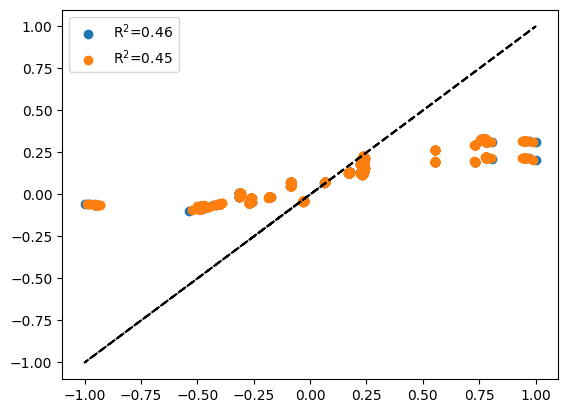

In [12]:
plt.scatter(y_train.flatten(),y_train_pred.flatten(),label="R$^{2}$="+f"{r2_score(y_train.flatten(),y_train_pred.flatten()):.2f}")
plt.plot(y_train.flatten(),y_train.flatten(),'k--')
plt.scatter(y_test.flatten(),y_test_pred.flatten(),label="R$^{2}$="+f"{r2_score(y_test.flatten(),y_test_pred.flatten()):.2f}")
plt.legend()
plt.show()

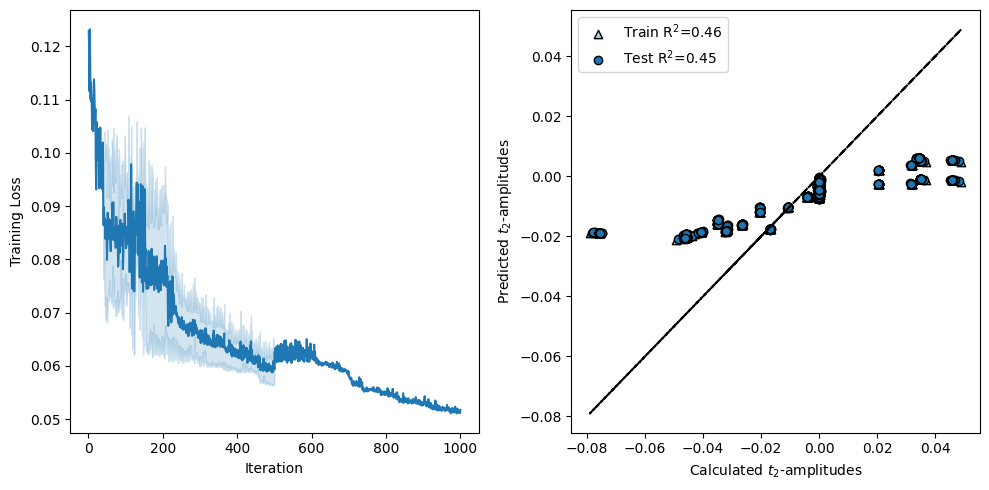

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
cmap = sns.color_palette("Paired",2)
fig, (ax1, ax2) = plt.subplots(1,2,figsize=(10,5))

sns.lineplot(data=pd.read_csv('model_log.csv',index_col=0).dropna(),x='Iteration',y='Cost',ax=ax1,color=cmap[1])
ax1.set_ylabel("Training Loss")
plt.scatter(unscaled_y_train.flatten(),unscaled_y_train_pred.flatten(),label="Train R$^{2}$="+f"{r2_score(unscaled_y_train.flatten(),unscaled_y_train_pred.flatten()):.2f}",color=cmap[0],marker='^',edgecolors='k')
ax2.plot(unscaled_y_train.flatten(),unscaled_y_train.flatten(),'k--')
ax2.scatter(unscaled_y_test.flatten(),unscaled_y_test_pred.flatten(),label="Test R$^{2}$="+f"{r2_score(unscaled_y_test.flatten(),unscaled_y_test_pred.flatten()):.2f}",color=cmap[1],marker='o',edgecolors='k')
ax2.set_xlabel('Calculated $t_2$-amplitudes')
ax2.set_ylabel('Predicted $t_2$-amplitudes')
ax2.legend()
plt.tight_layout()
# plt.savefig(os.path.join(os.path.expanduser('~'),"qregress/images/DDCC/qiskit_statevector_0.1.png"),dpi=300,bbox_inches='tight')
plt.savefig("3W_qiskit_statevector_0.1.png",dpi=300,bbox_inches='tight')
plt.show()